In [1]:
#Data
import pandas as pd
billboard = pd.read_csv("./datasets/billboard100.csv")
summer0010s = pd.read_csv("./datasets/summer0010s.csv")
f1980 = pd.read_csv("./datasets/1990s.csv")
f1990 = pd.read_csv("./datasets/1990s.csv")
f2000 = pd.read_csv("./datasets/2000s.csv")
f2010 = pd.read_csv("./datasets/2010s.csv")


In [2]:

import numpy as np
import seaborn as sns

#plotlys
import plotly.plotly as py
import plotly.graph_objs as go
from plotly.tools import FigureFactory as ff
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

#jupyter setup
init_notebook_mode(connected=True)
import matplotlib.pyplot as plt
import re
from pandas.tools.plotting import autocorrelation_plot
from functools import reduce

#!pip install -U seaborn

#Jupyter Notebook
pd.options.display.max_rows = 1200
pd.options.display.max_columns = 500
pd.options.display.float_format = '{:,.3f}'.format

In [3]:
# Where to save the figures
import os
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "billboard"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "img", CHAPTER_ID)


def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

In [4]:
# Functions for cleansing
def name_slicer(name):
    repls = {'X ' : 'Featuring', 'x ' : 'Featuring', '&' : 'Featuring', '+':'Featuring', ',':'Featuring', 'Feat.':'Featuring','With':'Featuring'}
    if name in ['Earth, Wind & Fire','Blood, Sweat & Tears']:
        pass
    else:
        name = reduce(lambda a, kv: a.replace(*kv), repls.items(), name)
        if 'Featuring' in name:
            name = name[:name.find("Featuring")-1]
    return name

def get_featuring(name):
    repls = {'X' : '|', 'x ' : '|', '&' : '|', '+':'|', ',':'|', 'Feat.':'|','With':'|','Featuring':'|'}
    if name in ['Earth, Wind & Fire','Blood, Sweat & Tears']:
        pass
    else:
        name = reduce(lambda a, kv: a.replace(*kv), repls.items(), name)
        if '|' in name:
            name = name[2+name.find("|"):]
    return name
def get_Season(month):
    if month in (1,2,11,12):
        season = 'winter'
    elif month in (3,4,5):
        season = 'spring'
    elif month in (6,7,8):
        season = 'summer'
    else:
        season = 'autumn'
    return season
def seasonal_tops(season='winter', top_x = 11, rank =10, peak_rank=5, weeks_on_chart = 12, min_date = '1958-08-16', max_date = '2019-04-13'):
    df_season = billboard.groupby('season').get_group(season)
    temp_season = df_season.loc[df_season['rank'] <= rank, :].loc[df_season['weeks_on_chart'] >= 3, :]
    temp_season_time =  temp_season.loc[df_season['date_'] >= min_date, :].loc[temp_season['date_'] <= max_date, :]
    temp_season_time = temp_season_time[['title', 'artist','unique']] 
    temp_season_time['unique'] = temp_season_time['unique'].str.replace('|', ' - ', regex=False)
    temp_season_time_cnt = temp_season_time['unique'].value_counts().to_frame().reset_index()
    temp_season_time_cnt.columns = ['track', 'counts']

    return temp_season_time_cnt

In [5]:
billboard.replace('-',np.nan,inplace=True)
billboard['artist1'] = billboard['artist'].apply(lambda x: name_slicer(x))
billboard['featuring'] = billboard['artist'].apply(lambda x: get_featuring(x))
billboard.last_week_rank = billboard['last_week_rank'].astype('float64')
billboard['rank_delta'] = billboard.last_week_rank - billboard['rank']
billboard['year'] = pd.DatetimeIndex(billboard['date_']).year
billboard['month'] = pd.DatetimeIndex(billboard['date_']).month
billboard['week'] = pd.DatetimeIndex(billboard['date_']).week
billboard['unique'] = billboard.artist + '|' + billboard.title
billboard['season'] = billboard['month'].apply(get_Season)

In [6]:
#Key dictionary
keys = {0:'C', 1:'C#/Db', 2:'D', 3:'D#/Eb', 4:'E', 5:'F', 6:'F#/Gb', 7:'G', 8:'G#/Ab', 9:'A', 10:'A#/Bb', 11:'B', 12:'C'}

In [7]:
#initilizing f1980a dataframe: Billboard + Spotify
bill1980 = billboard.loc[billboard['date_'] >= '1980-01-01', :].loc[billboard['date_'] <= '1989-12-31', :]
f1980a = bill1980.merge(f1980, left_on ='unique', right_on = 'unique', how='inner')
f1980a['decade'] = '1980s'
#initilizing f1990a dataframe: Billboard + Spotify
bill1990 = billboard.loc[billboard['date_'] >= '1990-01-01', :].loc[billboard['date_'] <= '1999-12-31', :]
f1990a = bill1990.merge(f1990, left_on ='unique', right_on = 'unique', how='inner')
f1990a['decade'] = '1990s'
#initilizing f2000a dataframe: Billboard + Spotify
bill2000 = billboard.loc[billboard['date_'] >= '2000-01-01', :].loc[billboard['date_'] <= '2009-12-31', :]
f2000a = bill2000.merge(f2000, left_on ='unique', right_on = 'unique', how='inner')
f2000a['decade'] = '2000s'
#initilizing f2010a dataframe: Billboard + Spotify
bill2010 = billboard.loc[billboard['date_'] >= '2010-01-01', :].loc[billboard['date_'] <= '2019-4-13', :]
f2010a = bill2010.merge(f2010, left_on ='unique', right_on = 'unique', how='inner')
f2010a['decade'] = '2010s'

In [8]:
#f1980a + f1990a + f2000a
temp = f1980a.append(f1990a).sort_values(by='date_').reset_index().drop(['index'],axis=1)
f80_00a = temp.append(f2000a).sort_values(by='date_').reset_index().drop(['index'],axis=1)
f80_10a = f80_00a.append(f2010a).sort_values(by='date_').reset_index().drop(['index'],axis=1)

In [9]:
# + f1990a + f2000a
temp = f1990a.append(f2000a).sort_values(by='date_').reset_index().drop(['index'],axis=1)
f90_10a = temp.append(f2010a).sort_values(by='date_').reset_index().drop(['index'],axis=1)

In [32]:
temp = f90_10a
temp['unique'] = temp['unique'].str.replace('|', ' - ', regex=False)
g = temp.loc[temp['unique'].isin(tmp_summer_10['track'])].drop_duplicates(['unique'])

In [35]:
df=g

data = []
clusters = []
colors = ['hsl('+str(h)+',50%'+',50%)' for h in np.linspace(0, 360, 1028)]

for i in range(len(df['title'].unique())):
    name = df['title'].unique()[i]
    color = colors[i]
    x = df[ df['title'] == name ]['energy']
    y = df[ df['title'] == name ]['valence']
    z = df[ df['title'] == name ]['danceability']
    
    trace = dict(
        name = name,
        x = x, y = y, z = z,
        type = "scatter3d",    
        mode = 'markers',
        
        marker = dict(size=4, color=color, line=dict(width=0), opacity=0.7 ) )
    data.append( trace )

layout = dict(
    width=800,
    height=550,
    autosize=True,
    title="3 Features: The Beatles",
    scene=dict(
        xaxis=dict(
            title='Energy',
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=True,
            backgroundcolor='rgb(230, 230,230)'
        ),
        yaxis=dict(
            title='Valence',
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=True,
            backgroundcolor='rgb(230, 230,230)'
        ),
        zaxis=dict(
            title='polarity',
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=True,
            backgroundcolor='rgb(230, 230,230)'
        ),
        aspectratio = dict( x=1, y=1, z=0.7 ),
        aspectmode = 'manual'        
    ),
showlegend = False,
)

fig = dict(data=data, layout=layout)
iplot(fig, filename='3d', validate=False)


In [27]:

df_summer = billboard.groupby('season').get_group('summer') #Summer
# Weeks on chart >= 12. Rank <= 5
summer_10 = df_summer.loc[df_summer['rank'] <= 5, :].loc[df_summer['weeks_on_chart'] >= 12, :]
summer_102010s = summer_10.loc[df_summer['date_'] >= '2000-01-01', :]
summer_102010s = summer_102010s[['title', 'artist','unique']]
summer_102010s['unique'] = summer_102010s['unique'].str.replace('|', ' - ', regex=False)
summer_2010s_cnt_10 = summer_102010s['unique'].value_counts().to_frame().reset_index()
summer_2010s_cnt_10.columns = ['track', 'counts']
tmp_summer_10 = summer_2010s_cnt_10.iloc[np.arange(0,11),:]
tmp_summer_10.reset_index(drop=  True, inplace = True)
tmp_summer_10


0     Luis Fonsi & Daddy Yankee Featuring Justin Bie...
1                      Carly Rae Jepsen - Call Me Maybe
2              Iggy Azalea Featuring Charli XCX - Fancy
3                       Bruno Mars - That's What I Like
4     Wiz Khalifa Featuring Charlie Puth - See You A...
5     LMFAO Featuring Lauren Bennett & GoonRock - Pa...
6                           Adele - Rolling In The Deep
7                         Imagine Dragons - Radioactive
8     Gotye Featuring Kimbra - Somebody That I Used ...
9                                   Aaliyah - Try Again
10    The Chainsmokers Featuring Daya - Don't Let Me...
Name: track, dtype: object

Saving figure Summer_'Hot100'_2000s-2010s


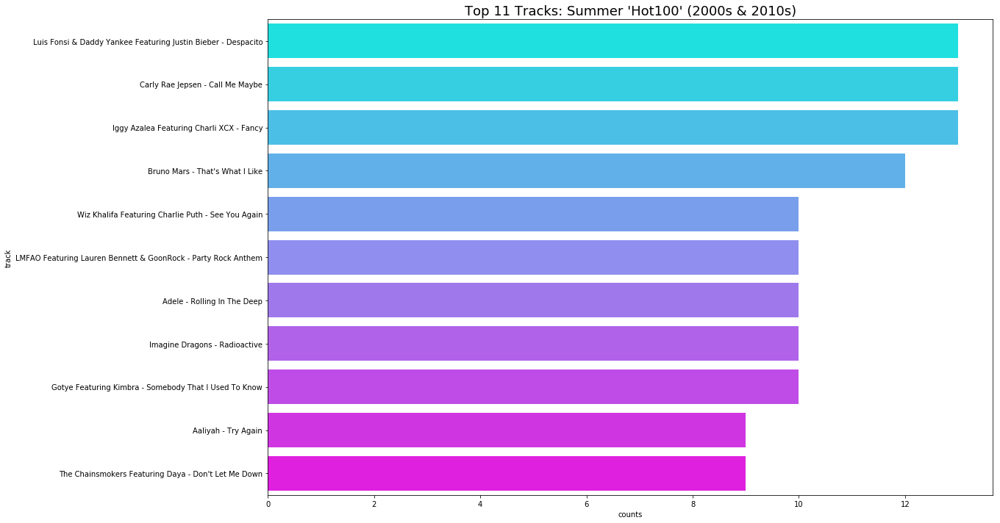

In [11]:
#### ANALYSIS 1
#Summer Chart
plt.figure(figsize = (19,10))
ax = plt.subplot(1,1,1)
sns.barplot(y = 'track', x = 'counts', data = tmp_summer_10, ax = ax, palette = plt.cm.cool(np.linspace(0,1,11)))
plt.title("Top 11 Tracks: Summer 'Hot100' (2000s & 2010s)", fontsize=18)
save_fig("Summer_'Hot100'_2000s-2010s")
plt.show()

In [12]:
#### ANALYSIS 2

# Billboard Top Artist Award Validation Table 1
print(billboard.loc[billboard['date_'] >= '2017-04-08', :].loc[billboard['date_'] <= '2018-03-31', :].artist1.value_counts()[:5])


Kendrick Lamar     166
Post Malone        122
Drake              109
Ed Sheeran         101
Imagine Dragons    100
Name: artist1, dtype: int64


In [167]:
s 

Maroon 5 Featuring Cardi B|Girls Like You                               33
Travis Scott|Sicko Mode                                                 32
Marshmello & Bastille|Happier                                           26
Juice WRLD|Lucid Dreams                                                 25
Halsey|Without Me                                                       23
Cardi B, Bad Bunny & J Balvin|I Like It                                 21
Post Malone|Better Now                                                  19
Post Malone & Swae Lee|Sunflower (Spider-Man: Into The Spider-Verse)    18
Drake|God's Plan                                                        17
Drake|Nice For What                                                     17
Name: unique, dtype: int64

In [168]:
# Billboard Top Artist Award Validation Table 2
award_2018 = billboard.loc[billboard['date_'] >= '2018-04-01', :].loc[billboard['date_'] <= '2019-04-13', :]
s = award_2018.loc[award_2018['rank']<=10,:].unique.value_counts()[:10]
testing2 = award_2018.loc[award_2018['unique'].isin(s.index.values)]
testing2.groupby(['artist1','title']).agg({'rank':['count','median','mean'],'peak_rank':['min'],'weeks_on_chart':['max']})

j = []
for i in testing2.week:
    if i <= 14:
        j.append(i + 38)
    else:
        j.append(i - 14)
testing2.week = np.asarray(j)
testing2['unique'] = testing2['unique'].str.replace('|', ' - ', regex=False)

C:\Users\Young Min Cho\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [169]:
testing2.groupby(['artist1','title']).agg({'rank':['count','median','mean'],'peak_rank':['min'],'weeks_on_chart':['max']})

rank         \
                                                           count median   
artist1      title                                                        
Cardi        I Like It                                        51 18.000   
Drake        God's Plan                                       27  6.000   
             Nice For What                                    25  4.000   
Halsey       Without Me                                       26  3.000   
Juice WRLD   Lucid Dreams                                     46  8.500   
Maroon 5     Girls Like You                                   45  5.000   
Marshmello   Happier                                          33  6.000   
Post Malone  Better Now                                       49 14.000   
             Sunflower (Spider-Man: Into The Spider-Verse)    24  4.000   
Travis Scott Sicko Mode                                       35  6.000   

                                                                  peak_rank  \
                                                             mean       min   
artist1      title                                                            
Cardi        I Like It                                     19.569     1.000   
Drake        God's Plan                                    13.333     1.000   
             Nice For What                                 10.000     1.000   
Halsey       Without Me                                     4.923     1.000   
Juice WRLD   Lucid Dreams                                  17.152     2.000   
Maroon 5     Girls Like You                                 9.511     1.000   
Marshmello   Happier                                       12.273     2.000   
Post Malone  Better Now                                    15.673     3.000   
             Sunflower (Spider-Man: Into The Spider-Verse)  7.750     1.000   
Travis Scott Sicko Mode                                     6.371     1.000   

                                                           weeks_on_chart  
                                                                      max  
artist1      title                                                         
Cardi        I Like It                                             51.000  
Drake        God's Plan                                            36.000  
             Nice For What                                         25.000  
Halsey       Without Me                                            26.000  
Juice WRLD   Lucid Dreams                                          46.000  
Maroon 5     Girls Like You                                        45.000  
Marshmello   Happier                                               33.000  
Post Malone  Better Now                                            49.000  
             Sunflower (Spider-Man: Into The Spider-Verse)         24.000  
Travis Scott Sicko Mode                                            35.000

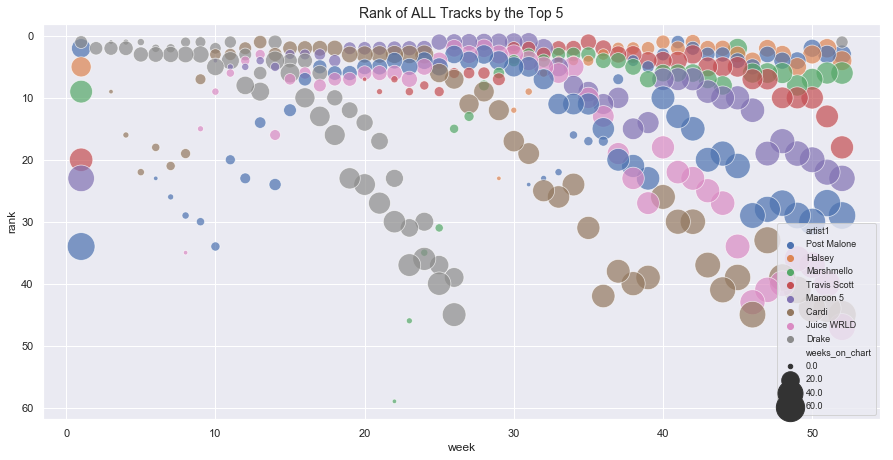

In [170]:
ax = sns.scatterplot(x="week", y="rank", hue="artist1",size="weeks_on_chart",sizes=(20, 800), data=testing2,alpha=0.7)
plt.gca().invert_yaxis()
plt.title("Rank of ALL Tracks by the Top 5", fontsize=14)
plt.legend(loc='lower right', fontsize=9)


In [92]:
# Billboard Top Artist Award Validation Table 2
award_2018 = billboard.loc[billboard['date_'] >= '2017-04-08', :].loc[billboard['date_'] <= '2018-03-31', :]
s = award_2018.loc[award_2018['rank']<=10,:].unique.value_counts()[:10]
testing = award_2018.loc[award_2018['unique'].isin(s.index.values)]
testing.groupby(['artist1','title']).agg({'rank':['count','median','mean'],'peak_rank':['min'],'weeks_on_chart':['max']})

j = []
for i in testing.week:
    if i <= 13:
        j.append(i + 39)
    else:
        j.append(i - 13)
testing.week = np.asarray(j)
testing['unique'] = testing['unique'].str.replace('|', ' - ', regex=False)

C:\Users\Young Min Cho\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [97]:
f90_10a

,artist_x,date_,last_week_rank,peak_rank,rank,title,weeks_on_chart,artist1,featuring,rank_delta,year,month,week,unique,season,artist_y,track,genres,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,id,uri,track_href,analysis_url,duration_ms,time_signature,decade
0,Michael Damian,1990-01-06,39.000,34.000,34,Was It Nothing At All,11.000,Michael Damian,Michael Damian,5.000,1990,1,1,Michael Damian - Was It Nothing At All,winter,Michael Damian,Was It Nothing At All,[],0.487,0.648,D,-5.332,1,0.028,0.040,0.001,0.321,0.442,134.950,audio_features,3SCeWq0qHsc8i2JxtJPSkd,spotify:track:3SCeWq0qHsc8i2JxtJPSkd,https://api.spotify.com/v1/tracks/3SCeWq0qHsc8...,https://api.spotify.com/v1/audio-analysis/3SCe...,282665,4,1990s
1,Gloria Estefan,1990-01-06,55.000,44.000,44,Here We Are,4.000,Gloria Estefan,Gloria Estefan,11.000,1990,1,1,Gloria Estefan - Here We Are,winter,Gloria Estefan,Here We Are,"['dance pop', 'latin pop', 'new wave pop']",0.694,0.467,A,-14.437,1,0.033,0.639,0.000,0.087,0.630,142.132,audio_features,4asTNYhhrp323lLp81KIKQ,spotify:track:4asTNYhhrp323lLp81KIKQ,https://api.spotify.com/v1/tracks/4asTNYhhrp32...,https://api.spotify.com/v1/audio-analysis/4asT...,289707,4,1990s
2,Soul II Soul,1990-01-06,6.000,4.000,11,Back To Life,16.000,Soul II Soul,Soul II Soul,-5.000,1990,1,1,Soul II Soul - Back To Life,winter,Soul II Soul,Back to Life,"['british soul', 'funk', 'hip house', 'new jac...",0.541,0.676,A,-6.604,0,0.134,0.004,0.005,0.289,0.403,202.190,audio_features,6R4k9g8R3vG6nXYR0z9tIC,spotify:track:6R4k9g8R3vG6nXYR0z9tIC,https://api.spotify.com/v1/tracks/6R4k9g8R3vG6...,https://api.spotify.com/v1/audio-analysis/6R4k...,315669,4,1990s
3,Tina Turner,1990-01-06,48.000,39.000,39,Steamy Windows,7.000,Tina Turner,Tina Turner,9.000,1990,1,1,Tina Turner - Steamy Windows,winter,Tina Turner,Steamy Windows - Live In Arnhem,"['disco', 'mellow gold', 'new wave pop', 'soft...",0.443,0.962,C#/Db,-3.011,0,0.068,0.002,0.255,0.987,0.334,141.946,audio_features,5wtGLlXwuK9I17140QqV84,spotify:track:5wtGLlXwuK9I17140QqV84,https://api.spotify.com/v1/tracks/5wtGLlXwuK9I...,https://api.spotify.com/v1/audio-analysis/5wtG...,265973,4,1990s
4,The B-52s,1990-01-06,88.000,70.000,70,Roam,3.000,The B-52s,The B-52s,18.000,1990,1,1,The B-52s - Roam,winter,The B-52s,Roam (Live),"['art rock', 'dance rock', 'new romantic', 'ne...",0.484,0.913,A,-7.048,1,0.059,0.000,0.000,0.908,0.471,124.997,audio_features,0c616Chn1OQGeQzY7GgI92,spotify:track:0c616Chn1OQGeQzY7GgI92,https://api.spotify.com/v1/tracks/0c616Chn1OQG...,https://api.spotify.com/v1/audio-analysis/0c61...,327805,4,1990s
5,Tesla,1990-01-06,16.000,15.000,15,Love Song,15.000,Tesla,Tesla,1.000,1990,1,1,Tesla - Love Song,winter,Tesla,"Love Song - Live at The Arco Arena, Sacramento...","['album rock', 'classic rock', 'glam metal', '...",0.205,0.811,F#/Gb,-5.498,1,0.045,0.119,0.155,0.971,0.258,82.772,audio_features,27Yx1aC780VdpmWSWWh70X,spotify:track:27Yx1aC780VdpmWSWWh70X,https://api.spotify.com/v1/tracks/27Yx1aC780Vd...,https://api.spotify.com/v1/audio-analysis/27Yx...,417573,4,1990s
6,Whitesnake,1990-01-06,37.000,37.000,46,Fool For Your Loving,18.000,Whitesnake,Whitesnake,-9.000,1990,1,1,Whitesnake - Fool For Your Loving,winter,Whitesnake,"Fool For Your Loving - Starkers Live In Tokyo,...","['album rock', 'british blues', 'classic rock'...",0.493,0.971,A,-9.202,1,0.783,0.494,0.000,0.713,0.712,121.658,audio_features,1pxBYehIluhFy6sOOGo9GC,spotify:track:1pxBYehIluhFy6sOOGo9GC,https://api.spotify.com/v1/tracks/1pxBYehIluhF...,https://api.spotify.com/v1/audio-analysis/1pxB...,106653,4,1990s
7,KISS,1990-01-06,73.000,66.000,83,Hide Your Heart,7.000,KISS,KISS,-10.000,1990,1,1,KISS - Hide Your Heart,winter,KISS,Hide Your Heart,"['album rock', 'classic rock', 'glam rock', 'h...",0.577,0.845,B,-10.070,0,0.072,0.345,0.000,0.145,0.553,122.358,audio_features,47o525G86mLspoGnUCaMd9,spotify:track:47o525G86mLspoGnUCaMd9,https://api.spotify.com/v1/tracks/47o525G86mLs...,https

In [96]:
f90_10a.groupby('year').agg({'danceability':['mean'],'tempo':['mean']})

,danceability,tempo
,mean,mean
year,,
1990,0.589,117.525
1991,0.593,121.742
1992,0.609,121.546
1993,0.629,118.622
1994,0.619,120.085
1995,0.628,122.491
1996,0.626,114.541
1997,0.654,121.464


Saving figure 2018_billboard_award


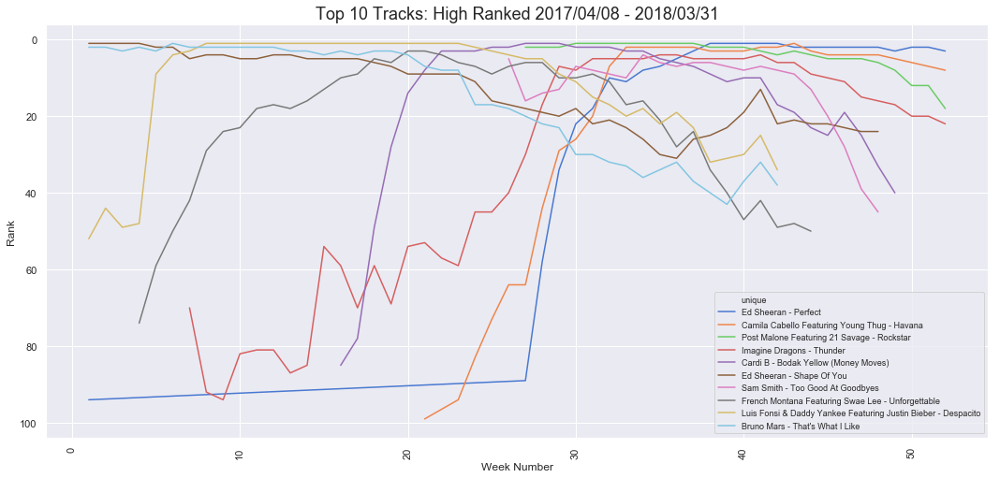

In [14]:
# Billboard Top Artist Award Validation Table 2


import calendar
sns.set(rc={'figure.figsize':(15,7.27)})
ax = sns.lineplot(x="week", y='rank', hue='unique', data=testing, palette="muted")
plt.gca().invert_yaxis()

#logit
plt.title("Top 10 Tracks: High Ranked 2017/04/08 - 2018/03/31", fontsize=18)
plt.xlabel('Week Number')
plt.ylabel('Rank')
plt.legend(loc='best', fontsize=9)
plt.xticks(rotation=90)
save_fig("2018_billboard_award")
plt.show()


In [90]:
award_2018b = f2010a.loc[f2010a['date_'] >= '2017-04-08', :].loc[f2010a['date_'] <= '2018-03-31', :]
ana2 = award_2018b[(award_2018b['artist1'].isin(testing.artist1.unique()))]
ana2.groupby('artist1')['danceability','energy','key','loudness','mode','valence','tempo'].mean()

,danceability,energy,key,loudness,mode,valence,tempo
artist1,,,,,,,
Bruno Mars,0.790,0.648,1.714,-5.048,0.857,0.743,129.827
Camila Cabello,0.727,0.579,1.409,-4.333,1.000,0.349,112.355
Cardi B,0.908,0.524,1.000,-7.955,1.000,0.109,138.015
Ed Sheeran,0.676,0.646,3.337,-4.409,0.525,0.618,104.735
French Montana,0.721,0.770,5.881,-5.051,0.976,0.728,98.537
Imagine Dragons,0.688,0.789,5.354,-4.640,0.465,0.481,145.759
Luis Fonsi,0.655,0.797,2.000,-4.787,1.000,0.839,177.928
Post Malone,0.618,0.636,5.869,-5.568,0.582,0.336,141.270
Sam Smith,0.639,0.373,5.160,-8.343,1.000,0.493,98.221


In [16]:
award_2018b.loc[award_2018b['rank']<=10].describe()[1:2]

,last_week_rank,peak_rank,rank,weeks_on_chart,rank_delta,year,month,week,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
mean,6.187,3.678,5.411,16.584,0.756,"2,017.248",6.575,26.398,0.717,0.644,4.973,-5.620,0.587,0.101,0.143,0.006,0.149,0.548,122.957,"216,502.472",3.958


In [17]:
#KEY ANALYSIS

In [18]:
f90_10a['year'].unique()

array([1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000,
       2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011,
       2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019], dtype=int64)

In [19]:
f90_10a = f90_10a.replace({"key": keys})

In [20]:
temp = f90_10a.groupby(['decade','key']).agg({'rank':['count','mean']})['rank']
temp=temp.reset_index()
temp_index = temp.groupby('key')['count'].sum().sort_values(ascending=False)[:-1]
plot_key = temp[temp['key'].isin(temp_index.index.values)]

Saving figure average_key_rank


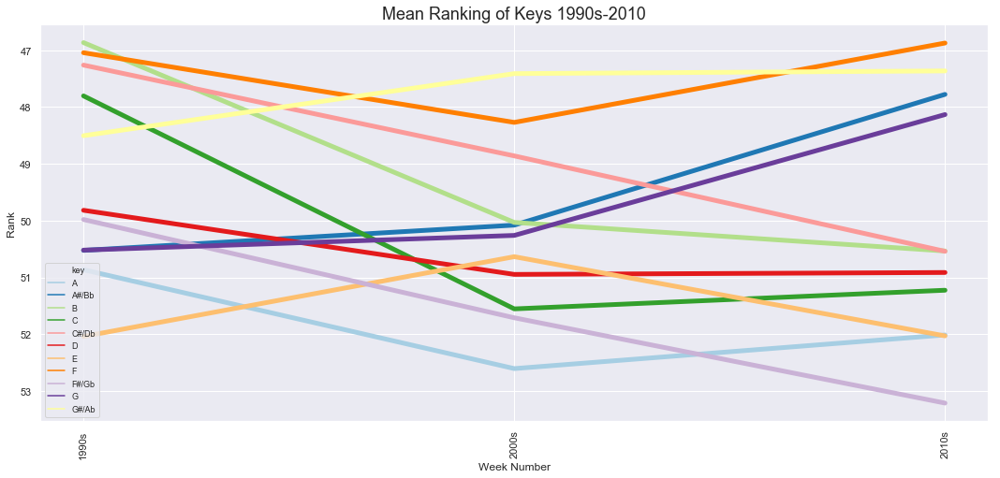

In [21]:
# Billboard Top Artist Award Validation Table 2
sns.set()
sns.set(rc={'figure.figsize':(15,7.27)})

ax = sns.lineplot(x="decade", y='mean',linewidth=5, hue='key', data=plot_key, palette="Paired")
plt.gca().invert_yaxis()

#logit
plt.title("Mean Ranking of Keys 1990s-2010", fontsize=18)
plt.xlabel('Week Number')
plt.ylabel('Rank')
plt.legend(loc='best', fontsize=9)
plt.xticks(rotation=90)
save_fig("average_key_rank")
plt.show()


In [22]:
f90_10a[f90_10a['key'] == 'G#/Ab'].loc[f90_10a['rank']<=5]

,artist_x,date_,last_week_rank,peak_rank,rank,title,weeks_on_chart,artist1,featuring,rank_delta,year,month,week,unique,season,artist_y,track,genres,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,id,uri,track_href,analysis_url,duration_ms,time_signature,decade
150,Jody Watley,1990-01-20,6.000,4.000,4,Everything,15.000,Jody Watley,Jody Watley,2.000,1990,1,3,Jody Watley|Everything,winter,Jody Watley,Everything You Do,"['disco', 'freestyle', 'minneapolis sound', 'n...",0.723,0.404,G#/Ab,-9.160,1,0.299,0.087,0.000,0.165,0.665,74.018,audio_features,1xXR3IYCrsMHMuCxwWOiDT,spotify:track:1xXR3IYCrsMHMuCxwWOiDT,https://api.spotify.com/v1/tracks/1xXR3IYCrsMH...,https://api.spotify.com/v1/audio-analysis/1xXR...,315093,4,1990s
225,Jody Watley,1990-01-27,4.000,4.000,4,Everything,16.000,Jody Watley,Jody Watley,0.000,1990,1,4,Jody Watley|Everything,winter,Jody Watley,Everything You Do,"['disco', 'freestyle', 'minneapolis sound', 'n...",0.723,0.404,G#/Ab,-9.160,1,0.299,0.087,0.000,0.165,0.665,74.018,audio_features,1xXR3IYCrsMHMuCxwWOiDT,spotify:track:1xXR3IYCrsMHMuCxwWOiDT,https://api.spotify.com/v1/tracks/1xXR3IYCrsMH...,https://api.spotify.com/v1/audio-analysis/1xXR...,315093,4,1990s
650,Alannah Myles,1990-03-10,9.000,4.000,4,Black Velvet,10.000,Alannah Myles,Alannah Myles,5.000,1990,3,10,Alannah Myles|Black Velvet,spring,Alannah Myles,Black Velvet,"['classic canadian rock', 'new wave pop']",0.754,0.366,G#/Ab,-10.070,1,0.031,0.273,0.000,0.106,0.469,91.147,audio_features,6bOJ0QcLYTgQZVs2wClMPb,spotify:track:6bOJ0QcLYTgQZVs2wClMPb,https://api.spotify.com/v1/tracks/6bOJ0QcLYTgQ...,https://api.spotify.com/v1/audio-analysis/6bOJ...,287440,4,1990s
719,Alannah Myles,1990-03-17,4.000,2.000,2,Black Velvet,11.000,Alannah Myles,Alannah Myles,2.000,1990,3,11,Alannah Myles|Black Velvet,spring,Alannah Myles,Black Velvet,"['classic canadian rock', 'new wave pop']",0.754,0.366,G#/Ab,-10.070,1,0.031,0.273,0.000,0.106,0.469,91.147,audio_features,6bOJ0QcLYTgQZVs2wClMPb,spotify:track:6bOJ0QcLYTgQZVs2wClMPb,https://api.spotify.com/v1/tracks/6bOJ0QcLYTgQ...,https://api.spotify.com/v1/audio-analysis/6bOJ...,287440,4,1990s
834,Alannah Myles,1990-03-24,2.000,1.000,1,Black Velvet,12.000,Alannah Myles,Alannah Myles,1.000,1990,3,12,Alannah Myles|Black Velvet,spring,Alannah Myles,Black Velvet,"['classic canadian rock', 'new wave pop']",0.754,0.366,G#/Ab,-10.070,1,0.031,0.273,0.000,0.106,0.469,91.147,audio_features,6bOJ0QcLYTgQZVs2wClMPb,spotify:track:6bOJ0QcLYTgQZVs2wClMPb,https://api.spotify.com/v1/tracks/6bOJ0QcLYTgQ...,https://api.spotify.com/v1/audio-analysis/6bOJ...,287440,4,1990s
835,Phil Collins,1990-03-24,8.000,5.000,5,I Wish It Would Rain Down,8.000,Phil Collins,Phil Collins,3.000,1990,3,12,Phil Collins|I Wish It Would Rain Down,spring,Phil Collins,I Wish It Would Rain Down - 2016 Remaster,"['mellow gold', 'soft rock']",0.510,0.667,G#/Ab,-4.715,1,0.029,0.292,0.007,0.313,0.356,125.887,audio_features,4F2t297QK40XFcIHqkmLHs,spotify:track:4F2t297QK40XFcIHqkmLHs,https://api.spotify.com/v1/tracks/4F2t297QK40X...,https://api.spotify.com/v1/audio-analysis/4F2t...,327747,4,1990s
887,Phil Collins,1990-03-31,5.000,3.000,3,I Wish It Would Rain Down,9.000,Phil Collins,Phil Collins,2.000,1990,3,13,Phil Collins|I Wish It Would Rain Down,spring,Phil Collins,I Wish It Would Rain Down - 2016 Remaster,"['mellow gold', 'soft rock']",0.510,0.667,G#/Ab,-4.715,1,0.029,0.292,0.007,0.313,0.356,125.887,audio_features,4F2t297QK40XFcIHqkmLHs,spotify:track:4F2t297QK40XFcIHqkmLHs,https://api.spotify.com/v1/tracks/4F2t297QK40X...,https://api.spotify.com/v1/audio-analysis/4F2t...,327747,4,1990s
899,Alannah Myles,1990-03-31,1.000,1.000,1,Black Velvet,13.000,Alannah Myles,Alannah Myles,0.000,1990,3,13,Alannah Myles|Black Velvet,spring,Alannah Myles,Black Velvet,"['classic canadian rock', 'new wave pop']",0.754,0.366,G#/Ab,-10.070,1,0.031,0.273,0.000,0.106,0.469,91.147,audio_features,6bOJ0QcLYTgQZVs2wClMPb,spotify:track:6bOJ0QcLYTgQZVs

In [72]:
x = pd.DataFrame.from_dict({'decade':['1990s','2000s','2010s'], 'polarity':[title90['polarity'].mean(),title00['polarity'].mean(),title10['polarity'].mean()]})

,decade,polarity
0,1990s,0.051
1,2000s,0.046
2,2010s,0.045


In [75]:
ax = sns.barplot(x='decade', y="polarity", data=x, palette  = 'Paired')
plt.title("Count of Keys 1990s-2010", fontsize=18)

ValueError: Could not interpret input 'decade'

Saving figure count_key


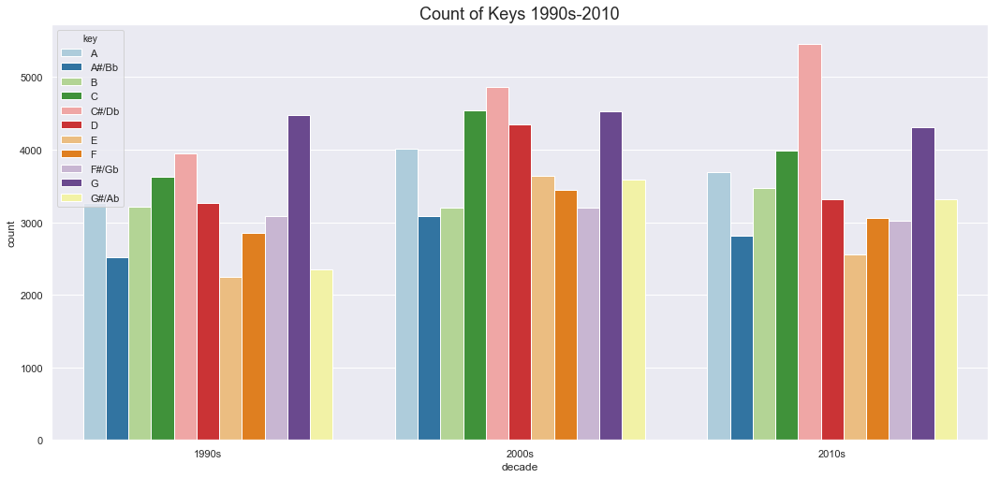

In [23]:
ax = sns.barplot(x="decade", y="count", hue="key", data=plot_key, palette  = 'Paired')
plt.title("Count of Keys 1990s-2010", fontsize=18)
save_fig("count_key")
plt.show()

In [24]:
#Top5 Artists
Top5 = award_2018b.groupby('artist1')['rank'].count().sort_values(ascending=False)[:5].index.values
ana2 = award_2018b[(award_2018b['artist1'].isin(Top5))]
j = []
for i in ana2.week:
    if i <= 13:
        j.append(i + 39)
    else:
        j.append(i - 13)
ana2.week = np.asarray(j)

Saving figure 2018_billboard_award2


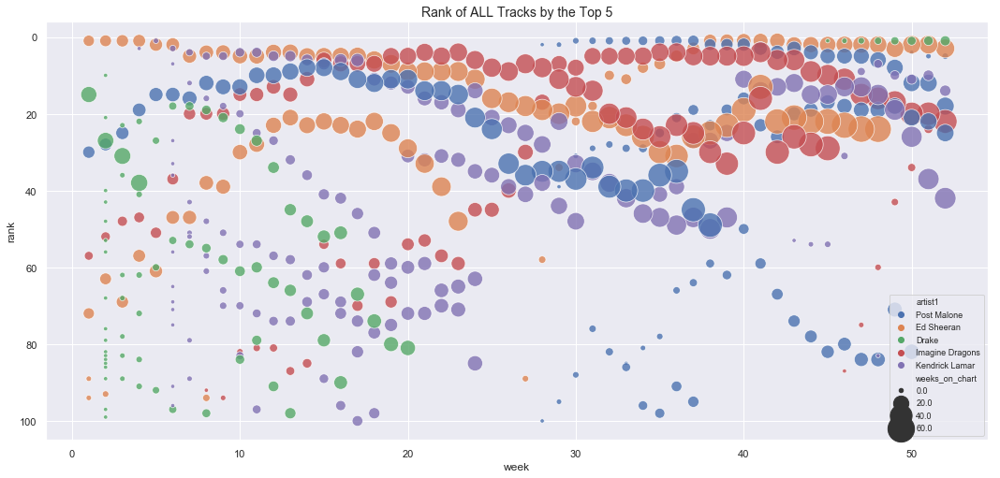

In [25]:
ax = sns.scatterplot(x="week", y="rank", hue="artist1",size="weeks_on_chart",sizes=(20, 800), data=ana2,alpha=0.8)
plt.gca().invert_yaxis()
plt.title("Rank of ALL Tracks by the Top 5", fontsize=14)
plt.legend(loc='lower right', fontsize=9)
save_fig("2018_billboard_award2")

In [26]:
# 1990s vs 2000s 
import plotly 
plotly.tools.set_credentials_file(username='choym92', api_key='Myh5ZJdHwzntkeXmtD4k')

data = [
   
  go.Scatterpolar(
  r = [f1990a['energy'].median(),f1990a['danceability'].median(),f1990a['valence'].median(),f1990a['key'].median()/11,f1990a['mode'].mean()
,f1990a['tempo'].median()/200],
  theta = ['energy','danceability','valence', 'key', 'mode', 'tempo'],
  fill = 'toself',
  name = '1990s',
  opacity = .5),
    
  go.Scatterpolar(
  r = [f2000a['energy'].median(),f2000a['danceability'].median(),f2000a['valence'].median(),f2000a['key'].median()/11,f2000a['mode'].mean() 
,f2000a['tempo'].median()/200],
  theta = ['energy','danceability','valence', 'key', 'mode', 'tempo'],
  fill = 'toself',
  name = '2000s',
  opacity = .5
),
  go.Scatterpolar(
  r = [f2010a['energy'].median(),f2010a['danceability'].median(),f2010a['valence'].median(),f2010a['key'].median()/11,f2010a['mode'].mean() 
,f2010a['tempo'].median()/200],
  theta = ['energy','danceability','valence', 'key', 'mode', 'tempo'],
  fill = 'toself',
  name = '2010s',
  opacity = .5
)]

layout = go.Layout(
  title = 'Features Comparison: 1990s vs 2010s',font = dict(
      size = 15
    ),
  polar = dict(
    radialaxis = dict(
      visible = True,
      range = [0, .8]
    )
  ),
  showlegend = True
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename = "1990svs2010s")


C:\Users\Young Min Cho\Anaconda3\lib\site-packages\IPython\core\display.py:689: UserWarning:

Consider using IPython.display.IFrame instead



In [27]:
# 1990s vs 2000s 
import plotly 
plotly.tools.set_credentials_file(username='choym92', api_key='Myh5ZJdHwzntkeXmtD4k')

data = [
   
  go.Scatterpolar(
  r = [f1990a['energy'].median(),f1990a['danceability'].median(),f1990a['valence'].median(),f1990a['key'].median()/11,f1990a['mode'].mean()
,f1990a['tempo'].median()/200],
  theta = ['energy','danceability','valence', 'key', 'mode', 'tempo'],
  fill = 'toself',
  name = '1990s',
  opacity = 1),
    
  go.Scatterpolar(
  r = [f2000a['energy'].median(),f2000a['danceability'].median(),f2000a['valence'].median(),f2000a['key'].median()/11,f2000a['mode'].mean() 
,f2000a['tempo'].median()/200],
  theta = ['energy','danceability','valence', 'key', 'mode', 'tempo'],
  fill = 'toself',
  name = '2000s',
  opacity = 1
)]

layout = go.Layout(
  title = 'Features Comparison: 1990s vs 2000s',font = dict(
      size = 15
    ),
  polar = dict(
    radialaxis = dict(
      visible = True,
      range = [0, .8]
    )
  ),
  showlegend = True
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename = "1990svs2000s")


In [28]:
top10of20y = f80_00a.loc[f80_00a['peak_rank']<=10,:].drop_duplicates('unique')
top10of20y.loc[top10of20y['title'].isin(['I Will Always Love You','My Immortal'])].iloc[:, [10,15,5,17,18,19,27]]

,year,artist_y,title,genres,danceability,energy,valence
11061,1992,Whitney Houston,I Will Always Love You,"['dance pop', 'pop', 'r&b', 'urban contemporary']",0.220,0.226,0.093
55097,2004,Evanescence,My Immortal,"['alternative metal', 'nu metal', 'post-grunge']",0.253,0.267,0.147


In [29]:
df=top10of20y

data = []
clusters = []
colors = ['hsl('+str(h)+',50%'+',50%)' for h in np.linspace(0, 360, 1028)]

for i in range(len(df['title'].unique())):
    name = df['title'].unique()[i]
    color = colors[i]
    x = df[ df['title'] == name ]['energy']
    y = df[ df['title'] == name ]['valence']
    z = df[ df['title'] == name ]['danceability']
    
    trace = dict(
        name = name,
        x = x, y = y, z = z,
        type = "scatter3d",    
        mode = 'markers',
        
        marker = dict(size=4, color=color, line=dict(width=0), opacity=0.7 ) )
    data.append( trace )

layout = dict(
    width=800,
    height=550,
    autosize=True,
    title="3 Features: Every Top 10 of 1990-2009",
    scene=dict(
        xaxis=dict(
            title='Energy',
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=True,
            backgroundcolor='rgb(230, 230,230)'
        ),
        yaxis=dict(
            title='Valence',
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=True,
            backgroundcolor='rgb(230, 230,230)'
        ),
        zaxis=dict(
            title='Danceability',
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=True,
            backgroundcolor='rgb(230, 230,230)'
        ),
        aspectratio = dict( x=1, y=1, z=0.7 ),
        aspectmode = 'manual'        
    ),
showlegend = False,
)

fig = dict(data=data, layout=layout)
iplot(fig, filename='top10_of_20-years', validate=False)


In [30]:
import plotly 
plotly.tools.set_credentials_file(username='choym92', api_key='Myh5ZJdHwzntkeXmtD4k')
x = f2000['energy']
y = f2000['valence']
z = f2000['danceability']

trace1 = go.Scatter3d(
    x=x,
    y=y,
    z=z,
    mode='markers',
    marker=dict(
    size=4,
    color=z,
    colorscale='Viridis',
    opacity=0.5))

data = [trace1]
layout = go.Layout(
    margin=dict(
    l=0,
    r=0,
    b=0,
    t=0)
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='3D_plot')


In [88]:
f90_10a

,artist_x,date_,last_week_rank,peak_rank,rank,title,weeks_on_chart,artist1,featuring,rank_delta,year,month,week,unique,season,artist_y,track,genres,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,id,uri,track_href,analysis_url,duration_ms,time_signature,decade
0,Michael Damian,1990-01-06,39.000,34.000,34,Was It Nothing At All,11.000,Michael Damian,Michael Damian,5.000,1990,1,1,Michael Damian|Was It Nothing At All,winter,Michael Damian,Was It Nothing At All,,0.487,0.648,D,-5.332,1,0.028,0.040,0.001,0.321,0.442,134.950,audio_features,3SCeWq0qHsc8i2JxtJPSkd,spotify:track:3SCeWq0qHsc8i2JxtJPSkd,https://api.spotify.com/v1/tracks/3SCeWq0qHsc8...,https://api.spotify.com/v1/audio-analysis/3SCe...,282665,4,1990s
1,Gloria Estefan,1990-01-06,55.000,44.000,44,Here We Are,4.000,Gloria Estefan,Gloria Estefan,11.000,1990,1,1,Gloria Estefan|Here We Are,winter,Gloria Estefan,Here We Are,,0.694,0.467,A,-14.437,1,0.033,0.639,0.000,0.087,0.630,142.132,audio_features,4asTNYhhrp323lLp81KIKQ,spotify:track:4asTNYhhrp323lLp81KIKQ,https://api.spotify.com/v1/tracks/4asTNYhhrp32...,https://api.spotify.com/v1/audio-analysis/4asT...,289707,4,1990s
2,Soul II Soul,1990-01-06,6.000,4.000,11,Back To Life,16.000,Soul II Soul,Soul II Soul,-5.000,1990,1,1,Soul II Soul|Back To Life,winter,Soul II Soul,Back to Life,,0.541,0.676,A,-6.604,0,0.134,0.004,0.005,0.289,0.403,202.190,audio_features,6R4k9g8R3vG6nXYR0z9tIC,spotify:track:6R4k9g8R3vG6nXYR0z9tIC,https://api.spotify.com/v1/tracks/6R4k9g8R3vG6...,https://api.spotify.com/v1/audio-analysis/6R4k...,315669,4,1990s
3,Tina Turner,1990-01-06,48.000,39.000,39,Steamy Windows,7.000,Tina Turner,Tina Turner,9.000,1990,1,1,Tina Turner|Steamy Windows,winter,Tina Turner,Steamy Windows - Live In Arnhem,,0.443,0.962,C#/Db,-3.011,0,0.068,0.002,0.255,0.987,0.334,141.946,audio_features,5wtGLlXwuK9I17140QqV84,spotify:track:5wtGLlXwuK9I17140QqV84,https://api.spotify.com/v1/tracks/5wtGLlXwuK9I...,https://api.spotify.com/v1/audio-analysis/5wtG...,265973,4,1990s
4,The B-52s,1990-01-06,88.000,70.000,70,Roam,3.000,The B-52s,The B-52s,18.000,1990,1,1,The B-52s|Roam,winter,The B-52s,Roam (Live),,0.484,0.913,A,-7.048,1,0.059,0.000,0.000,0.908,0.471,124.997,audio_features,0c616Chn1OQGeQzY7GgI92,spotify:track:0c616Chn1OQGeQzY7GgI92,https://api.spotify.com/v1/tracks/0c616Chn1OQG...,https://api.spotify.com/v1/audio-analysis/0c61...,327805,4,1990s
5,Tesla,1990-01-06,16.000,15.000,15,Love Song,15.000,Tesla,Tesla,1.000,1990,1,1,Tesla|Love Song,winter,Tesla,"Love Song - Live at The Arco Arena, Sacramento...",,0.205,0.811,F#/Gb,-5.498,1,0.045,0.119,0.155,0.971,0.258,82.772,audio_features,27Yx1aC780VdpmWSWWh70X,spotify:track:27Yx1aC780VdpmWSWWh70X,https://api.spotify.com/v1/tracks/27Yx1aC780Vd...,https://api.spotify.com/v1/audio-analysis/27Yx...,417573,4,1990s
6,Whitesnake,1990-01-06,37.000,37.000,46,Fool For Your Loving,18.000,Whitesnake,Whitesnake,-9.000,1990,1,1,Whitesnake|Fool For Your Loving,winter,Whitesnake,"Fool For Your Loving - Starkers Live In Tokyo,...",,0.493,0.971,A,-9.202,1,0.783,0.494,0.000,0.713,0.712,121.658,audio_features,1pxBYehIluhFy6sOOGo9GC,spotify:track:1pxBYehIluhFy6sOOGo9GC,https://api.spotify.com/v1/tracks/1pxBYehIluhF...,https://api.spotify.com/v1/audio-analysis/1pxB...,106653,4,1990s
7,KISS,1990-01-06,73.000,66.000,83,Hide Your Heart,7.000,KISS,KISS,-10.000,1990,1,1,KISS|Hide Your Heart,winter,KISS,Hide Your Heart,,0.577,0.845,B,-10.070,0,0.072,0.345,0.000,0.145,0.553,122.358,audio_features,47o525G86mLspoGnUCaMd9,spotify:track:47o525G86mLspoGnUCaMd9,https://api.spotify.com/v1/tracks/47o525G86mLs...,https://api.spotify.com/v1/audio-analysis/47o5...,266067,4,1990s
8,Alice Cooper,1990-01-06,45.000,7.000,57,Poison,16.000,Alice Cooper,Alice Cooper,-12.000,1990,1,1,Alice Cooper|Poison,winter,Alice Cooper,Poison - Live at the Olympia Paris,,0.323,0.896,A,-6.037,1,0.066,0.002,0.000,0.878,0.180,121.223,audio_features,2KbiceRvt4u6JaAYWX12Hp,spotify:track:2KbiceRvt4u6JaAYWX12

In [110]:
f90_10a.sort_values(by='instrumentalness',ascending = False)

,artist_x,date_,last_week_rank,peak_rank,rank,title,weeks_on_chart,artist1,featuring,rank_delta,year,month,week,unique,season,artist_y,track,genres,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,id,uri,track_href,analysis_url,duration_ms,time_signature,decade
43515,Darude,2001-08-25,83.000,83.000,92,Sandstorm,6.000,Darude,Darude,-9.000,2001,8,34,Darude|Sandstorm,summer,Darude,Sandstorm,,0.518,0.982,E,-7.130,0,0.043,0.016,0.989,0.033,0.498,136.033,audio_features,2lylyZl9S7rbp2FUP5IS0r,spotify:track:2lylyZl9S7rbp2FUP5IS0r,https://api.spotify.com/v1/tracks/2lylyZl9S7rb...,https://api.spotify.com/v1/audio-analysis/2lyl...,229573,4,2000s
43103,Darude,2001-07-21,nan,nan,92,Sandstorm,nan,Darude,Darude,nan,2001,7,29,Darude|Sandstorm,summer,Darude,Sandstorm,,0.518,0.982,E,-7.130,0,0.043,0.016,0.989,0.033,0.498,136.033,audio_features,2lylyZl9S7rbp2FUP5IS0r,spotify:track:2lylyZl9S7rbp2FUP5IS0r,https://api.spotify.com/v1/tracks/2lylyZl9S7rb...,https://api.spotify.com/v1/audio-analysis/2lyl...,229573,4,2000s
43786,Darude,2001-09-22,92.000,83.000,94,Sandstorm,10.000,Darude,Darude,-2.000,2001,9,38,Darude|Sandstorm,autumn,Darude,Sandstorm,,0.518,0.982,E,-7.130,0,0.043,0.016,0.989,0.033,0.498,136.033,audio_features,2lylyZl9S7rbp2FUP5IS0r,spotify:track:2lylyZl9S7rbp2FUP5IS0r,https://api.spotify.com/v1/tracks/2lylyZl9S7rb...,https://api.spotify.com/v1/audio-analysis/2lyl...,229573,4,2000s
43742,Darude,2001-09-15,97.000,83.000,92,Sandstorm,9.000,Darude,Darude,5.000,2001,9,37,Darude|Sandstorm,autumn,Darude,Sandstorm,,0.518,0.982,E,-7.130,0,0.043,0.016,0.989,0.033,0.498,136.033,audio_features,2lylyZl9S7rbp2FUP5IS0r,spotify:track:2lylyZl9S7rbp2FUP5IS0r,https://api.spotify.com/v1/tracks/2lylyZl9S7rb...,https://api.spotify.com/v1/audio-analysis/2lyl...,229573,4,2000s
43664,Darude,2001-09-08,95.000,83.000,97,Sandstorm,8.000,Darude,Darude,-2.000,2001,9,36,Darude|Sandstorm,autumn,Darude,Sandstorm,,0.518,0.982,E,-7.130,0,0.043,0.016,0.989,0.033,0.498,136.033,audio_features,2lylyZl9S7rbp2FUP5IS0r,spotify:track:2lylyZl9S7rbp2FUP5IS0r,https://api.spotify.com/v1/tracks/2lylyZl9S7rb...,https://api.spotify.com/v1/audio-analysis/2lyl...,229573,4,2000s
43312,Darude,2001-08-11,92.000,84.000,84,Sandstorm,4.000,Darude,Darude,8.000,2001,8,32,Darude|Sandstorm,summer,Darude,Sandstorm,,0.518,0.982,E,-7.130,0,0.043,0.016,0.989,0.033,0.498,136.033,audio_features,2lylyZl9S7rbp2FUP5IS0r,spotify:track:2lylyZl9S7rbp2FUP5IS0r,https://api.spotify.com/v1/tracks/2lylyZl9S7rb...,https://api.spotify.com/v1/audio-analysis/2lyl...,229573,4,2000s
43437,Darude,2001-08-18,84.000,83.000,83,Sandstorm,5.000,Darude,Darude,1.000,2001,8,33,Darude|Sandstorm,summer,Darude,Sandstorm,,0.518,0.982,E,-7.130,0,0.043,0.016,0.989,0.033,0.498,136.033,audio_features,2lylyZl9S7rbp2FUP5IS0r,spotify:track:2lylyZl9S7rbp2FUP5IS0r,https://api.spotify.com/v1/tracks/2lylyZl9S7rb...,https://api.spotify.com/v1/audio-analysis/2lyl...,229573,4,2000s
43292,Darude,2001-08-04,92.000,92.000,92,Sandstorm,3.000,Darude,Darude,0.000,2001,8,31,Darude|Sandstorm,summer,Darude,Sandstorm,,0.518,0.982,E,-7.130,0,0.043,0.016,0.989,0.033,0.498,136.033,audio_features,2lylyZl9S7rbp2FUP5IS0r,spotify:track:2lylyZl9S7rbp2FUP5IS0r,https://api.spotify.com/v1/tracks/2lylyZl9S7rb...,https://api.spotify.com/v1/audio-analysis/2lyl...,229573,4,2000s
43176,Darude,2001-07-28,92.000,92.000,92,Sandstorm,2.000,Darude,Darude,0.000,2001,7,30,Darude|Sandstorm,summer,Darude,Sandstorm,,0.518,0.982,E,-7.130,0,0.043,0.016,0.989,0.033,0.498,136.033,audio_features,2lylyZl9S7rbp2FUP5IS0r,spotify:track:2lylyZl9S7rbp2FUP5IS0r,https://api.spotify.com/v1/tracks/2lylyZl9S7rb...,https://api.spotify.com/v1/audio-analysis/2lyl...,229573,4,2000s
43555,Darude,2001-09-01,92.000,83.000,95,Sandstorm,7.000,Darude,Darude,-3.000,2001,9,35,Darude|Sandstorm,autumn,Darude,Sandstorm,,0.518,0.982,E,-7.130,0,0.043,0.016,0.989,0.033,0.498,136.033,audio_features,2lylyZl9S7rbp2FUP5IS0r,spotify:track:2lylyZl9S7rbp2FUP5IS0r

In [114]:
temp1.sort_values(by=['instrumentalness','year'],ascending = False)

,artist_x,date_,last_week_rank,peak_rank,rank,title,weeks_on_chart,artist1,featuring,rank_delta,year,month,week,unique,season,artist_y,track,genres,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,id,uri,track_href,analysis_url,duration_ms,time_signature,decade
43103,Darude,2001-07-21,nan,nan,92,Sandstorm,nan,Darude,Darude,nan,2001,7,29,Darude|Sandstorm,summer,Darude,Sandstorm,,0.518,0.982,E,-7.130,0,0.043,0.016,0.989,0.033,0.498,136.033,audio_features,2lylyZl9S7rbp2FUP5IS0r,spotify:track:2lylyZl9S7rbp2FUP5IS0r,https://api.spotify.com/v1/tracks/2lylyZl9S7rb...,https://api.spotify.com/v1/audio-analysis/2lyl...,229573,4,2000s
107766,Alan Walker,2016-04-30,nan,nan,91,Faded,nan,Alan Walker,Alan Walker,nan,2016,4,17,Alan Walker|Faded,spring,Alan Walker,Faded (Interlude),,0.347,0.306,F#/Gb,-19.755,1,0.038,0.761,0.967,0.166,0.086,179.792,audio_features,02Jk9LuQmKe6YYFfcRdXpY,spotify:track:02Jk9LuQmKe6YYFfcRdXpY,https://api.spotify.com/v1/tracks/02Jk9LuQmKe6...,https://api.spotify.com/v1/audio-analysis/02Jk...,41867,4,2010s
7467,Enya,1992-02-29,nan,nan,87,Caribbean Blue,nan,Enya,Enya,nan,1992,2,9,Enya|Caribbean Blue,winter,Enya,Caribbean Blue,,0.386,0.319,E,-16.512,1,0.033,0.776,0.965,0.106,0.661,157.614,audio_features,31TAub5WKWEsVTJcdksxq7,spotify:track:31TAub5WKWEsVTJcdksxq7,https://api.spotify.com/v1/tracks/31TAub5WKWEs...,https://api.spotify.com/v1/audio-analysis/31TA...,239600,3,1990s
68357,Incubus,2007-05-05,nan,nan,99,Dig,nan,Incubus,Incubus,nan,2007,5,18,Incubus|Dig,spring,Incubus,Make No Sound In The Digital Forest,,0.451,0.753,B,-7.596,1,0.031,0.087,0.952,0.109,0.370,128.475,audio_features,20GXDOFS71AAJ84oj2MPrF,spotify:track:20GXDOFS71AAJ84oj2MPrF,https://api.spotify.com/v1/tracks/20GXDOFS71AA...,https://api.spotify.com/v1/audio-analysis/20GX...,203973,4,2000s
61732,Avenged Sevenfold,2005-11-12,nan,nan,87,Bat Country,nan,Avenged Sevenfold,Avenged Sevenfold,nan,2005,11,45,Avenged Sevenfold|Bat Country,winter,Avenged Sevenfold,Bat Country Theme,,0.556,0.676,C,-6.950,1,0.035,0.061,0.952,0.531,0.228,139.970,audio_features,4NvvqUAqTXuifVAXh3iTTZ,spotify:track:4NvvqUAqTXuifVAXh3iTTZ,https://api.spotify.com/v1/tracks/4NvvqUAqTXui...,https://api.spotify.com/v1/audio-analysis/4Nvv...,280187,4,2000s
12308,Tony Toni Tone,1993-06-12,nan,nan,77,If I Had No Loot,nan,Tony Toni Tone,Tony Toni Tone,nan,1993,6,23,Tony Toni Tone|If I Had No Loot,summer,Tony Toni Tone,If I Had No Loot,,0.951,0.466,D,-7.808,1,0.065,0.346,0.952,0.094,0.964,106.076,audio_features,6yg5A6yiu5kDN9Kiil7iUr,spotify:track:6yg5A6yiu5kDN9Kiil7iUr,https://api.spotify.com/v1/tracks/6yg5A6yiu5kD...,https://api.spotify.com/v1/audio-analysis/6yg5...,65480,4,1990s
26020,Tony Toni Tone,1997-05-10,nan,nan,44,Thinking Of You,nan,Tony Toni Tone,Tony Toni Tone,nan,1997,5,19,Tony Toni Tone|Thinking Of You,spring,Tony Toni Tone,Thinking of You,,0.616,0.412,B,-13.380,1,0.108,0.169,0.939,0.105,0.907,195.873,audio_features,7c7jFfzfqNqk3gDphoF67r,spotify:track:7c7jFfzfqNqk3gDphoF67r,https://api.spotify.com/v1/tracks/7c7jFfzfqNqk...,https://api.spotify.com/v1/audio-analysis/7c7j...,60893,4,1990s
60732,T-Pain,2005-08-27,nan,nan,100,I'm Sprung,nan,T-Pain,T-Pain,nan,2005,8,34,T-Pain|I'm Sprung,summer,T-Pain,I'm Sprung - Instrumental,,0.957,0.198,F,-12.639,0,0.158,0.006,0.922,0.086,0.117,100.009,audio_features,3bLX6IhKVBYPCJ8sJOq2YL,spotify:track:3bLX6IhKVBYPCJ8sJOq2YL,https://api.spotify.com/v1/tracks/3bLX6IhKVBYP...,https://api.spotify.com/v1/audio-analysis/3bLX...,243040,4,2000s
82818,Soundgarden,2010-09-04,nan,nan,96,Black Rain,nan,Soundgarden,Soundgarden,nan,2010,9,35,Soundgarden|Black Rain,autumn,Soundgarden,Black Rain (Black Days) - Studio Outtake,,0.160,0.867,G,-6.353,0,0.052,0.000,0.920,0.117,0.393,87.894,audio_features,32TOkclYInkRzc6N8uvl4x,spotify:track:32TOkclYInkRzc6N8uvl4x,https://api.spotify.com/v1/tracks/32TOkclYInkR...,https://api.spotify.com/v1/audio-analysis/32TO...,298533,4,2010s
118932,XXXTENTACION,2018-12-22,na

In [112]:
temp1 = f90_10a.drop_duplicates(['unique'])
temp = temp1.groupby('year')['instrumentalness','tempo','loudness','acousticness'].mean()
g = pd.DataFrame(temp, columns=['instrumentalness','tempo','loudness','acousticness']).reset_index()
g['acousticness'] = g['acousticness']/g['acousticness'].max()
g['loudness'] = g['loudness']/g['loudness'].max()
g['instrumentalness'] = g['instrumentalness']/g['instrumentalness'].max()
g['tempo'] = g['tempo']/g['tempo'].max()

In [130]:
temp = f90_10a.groupby('decade').agg({'title':['count']}).sort_index()
temp = pd.DataFrame(temp.to_records())
temp.columns = ['decade','t_counts']
temp

IndexError: index 2 is out of bounds for axis 0 with size 2

In [118]:
import plotly.plotly as py
import plotly.graph_objs as go

# Create random data with numpy
import numpy as np


# Create traces
trace0 = go.Scatter(
    x = g['year'],
    y = g['acousticness'],
    mode = 'lines+markers',
    name = 'acousticness'
)
trace1 = go.Scatter(
    x = g['year'],
    y = g['loudness'],
    mode = 'lines+markers',
    name = 'loudness'
)
trace2 = go.Scatter(
    x = g['year'],
    y = g['instrumentalness'],
    mode = 'lines+markers',
    name = 'instrumentalness'
)
trace3 = go.Scatter(
    x = g['year'],
    y = g['tempo'],
    mode = 'lines+markers',
    name = 'tempo'
)

data = [trace0, trace1, trace2,trace3]

py.iplot(data, filename='line-mode')

C:\Users\Young Min Cho\Anaconda3\lib\site-packages\IPython\core\display.py:689: UserWarning:

Consider using IPython.display.IFrame instead



No handles with labels found to put in legend.


Saving figure Mean_Instrumentalnes


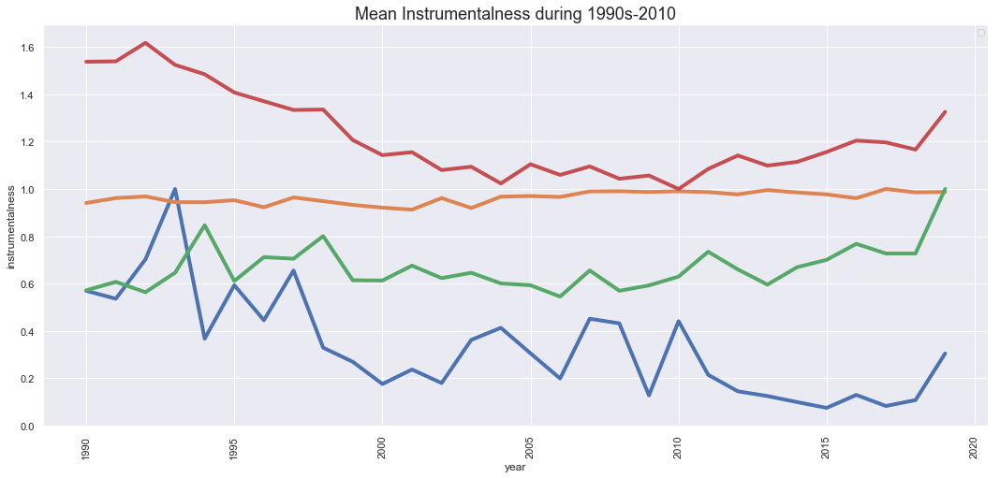

In [113]:
# Billboard Top Artist Award Validation Table 2
sns.set()
sns.set(rc={'figure.figsize':(15,7.27)})

ax = sns.lineplot(x="year", y='instrumentalness',linewidth=4, data=g, palette="Paired")
ax = sns.lineplot(x="year", y='tempo',linewidth=4, data=g, palette="Paired")
ax = sns.lineplot(x="year", y='acousticness',linewidth=4, data=g, palette="Paired")
ax = sns.lineplot(x="year", y='loudness',linewidth=4, data=g, palette="Paired")
#logit
plt.title("Mean Instrumentalness during 1990s-2010", fontsize=18)
plt.xlabel('year')
plt.ylabel('instrumentalness')
plt.legend(loc='best', fontsize=9)
plt.xticks(rotation=90)
save_fig("Mean_Instrumentalnes")
plt.show()


In [196]:
f90_10a["gen"] = f90_10a['genres'].str.replace('[^\w\s]','')

In [194]:
import string
def countWord(string_1):
    '''
    1. count the number of frequencies of each word occur.
    2. case insensitive
    3. remove all punctuations
    
    Arguments:
    string_1: string to be checked
    
    Returns:
    hist: dictionary of each word
    '''
    # punctuation list
    exclude = list(string.punctuation)
    # case insensitive
    string_1 = string_1.upper().lower()
    
    # remove punctuations
    temp_s = ""
    for i in string_1:
        if i in exclude:
            temp_s = temp_s + ""
        else:
            temp_s = temp_s + i
    # split()        
    for word in ['raegaeton','r&b','k-pop','adult standards','children','techno','hip hop','country','rock','ccm','rap']:
        if 'rb' in temp_s:
            return 'r&b'
        elif 'kpop' in temp_s:
            return 'k-pop'
        elif word in temp_s:
            hist = temp_s[temp_s.find(word):temp_s.find(word)+len(word)]
            return hist
        elif 'hip hop' in temp_s:
            return 'hip hop'
        elif 'rap' in temp_s:
            return 'rap'
        else:
    # count in dictionary
            hist={}
            for i in temp_s.split():
                if i in hist:
                    hist[i] += 1
                else:
                    hist[i] = 1
    return max(hist, key=hist.get)

In [ ]:
#####################NLP###################

In [36]:
import nltk

# Uncomment the following line the first time you run the code
# nltk.download('stopwords')
# nltk.download('wordnet')

In [37]:
sample_text = "This is a toy example. Illustrate this example below."
sample_tokens = sample_text.split()
print(sample_tokens)
from nltk.tokenize import word_tokenize 
word_tokenize(sample_text)
from textblob import TextBlob
TextBlob(sample_text).words
from nltk.stem import PorterStemmer
stemmer = PorterStemmer()
from nltk import WordNetLemmatizer
lemztr = WordNetLemmatizer()

['This', 'is', 'a', 'toy', 'example.', 'Illustrate', 'this', 'example', 'below.']


In [38]:
input_list = ['all', 'this', 'happened', 'more', 'or', 'less']

def find_ngrams(input_list, n):
    return list(zip(*[input_list[i:] for i in range(n)]))
find_ngrams(input_list, 3)

[('all', 'this', 'happened'),
 ('this', 'happened', 'more'),
 ('happened', 'more', 'or'),
 ('more', 'or', 'less')]

In [205]:
#DATA
lyrics =  pd.read_csv("datasets/lyrics.csv", encoding="ISO-8859-1")
spotify_data = pd.read_csv("datasets/data_/spotify_data.csv", encoding="ISO-8859-1")
yearly_hot_100s = pd.read_csv("datasets/data_/yearly_hot_100s.csv", encoding="ISO-8859-1")


In [216]:
lyrics['unique'] = lyrics['artist'] + ' - ' + lyrics['title']
spotify_data['unique'] = str(spotify_data['artist_name']) + ' - ' + spotify_data['track_name']
yearly_hot_100s['unique'] = str(yearly_hot_100s['artist']) + ' - ' + yearly_hot_100s['title']

In [39]:
# Fill na with empty string
f90_10a['title'] = f90_10a['title'].fillna('')
# Replace `removed` and `deleted` with empty string
tbr = ['[removed]', '[deleted]']
f90_10a['title'] = f90_10a['title'].apply(lambda x: '' if x in tbr else x)
print(sum(f90_10a['title'] == '') / f90_10a.shape[0])
# The first step is to remove punctuation, as it doesn’t add any extra information while treating text data. Therefore removing all instances of it will help us reduce the size of the training data.
f90_10a['title'] = f90_10a['title'].apply(lambda x: re.sub('[^\w\s]', '', x))
from nltk.corpus import stopwords
stop = stopwords.words('english')
stop = stop[4:]
f90_10a['title'] = f90_10a['title'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))


0.0


In [ ]:
# Fill na with empty string
lyrics['lyrics'] = lyrics['lyrics'].fillna('')
# Replace `removed` and `deleted` with empty string
tbr = ['[removed]', '[deleted]']
lyrics['lyrics'] = lyrics['lyrics'].apply(lambda x: '' if x in tbr else x)
print(sum(lyrics['lyrics'] == '') / lyrics.shape[0])
# fill in blanks with title
lyrics['lyrics'] = lyrics['title'] + ' ' + lyrics['lyrics']
# The first step is to remove punctuation, as it doesn’t add any extra information while treating text data. Therefore removing all instances of it will help us reduce the size of the training data.
lyrics['lyrics'] = lyrics['lyrics'].apply(lambda x: re.sub('[^\w\s]', '', x))
from nltk.corpus import stopwords
stop = stopwords.words('english')
stop = stop[4:]
lyrics['lyrics'] = lyrics['lyrics'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))


In [136]:
# Filter by each decade
title90s = f90_10a.loc[f90_10a.year//10*10 == 1990]
title00s = f90_10a.loc[f90_10a.year//10*10 == 2000]
title10s = f90_10a.loc[f90_10a.year//10*10 == 2010]

In [137]:
title90s = title90s.drop_duplicates('unique')
title10s = title10s.drop_duplicates('unique')
title00s = title00s.drop_duplicates('unique')




title00s.shape

(2747, 37)

In [141]:
sample_size = title10s.shape[0]

def sentiment_func(x):
    sentiment = TextBlob(x['title'])
    x['polarity'] = sentiment.polarity
    x['subjectivity'] = sentiment.subjectivity
    return x

title10 = title10s.sample(sample_size, replace=True).apply(sentiment_func, axis=1)

In [139]:
title90.sort_values(by=['polarity'])

,artist_x,date_,last_week_rank,peak_rank,rank,title,weeks_on_chart,artist1,featuring,rank_delta,year,month,week,unique,season,artist_y,track,genres,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,id,uri,track_href,analysis_url,duration_ms,time_signature,decade,polarity,subjectivity
12595,Cypress Hill,1993-07-10,nan,nan,47,Insane In The Brain,nan,Cypress Hill,Cypress Hill,nan,1993,7,27,Cypress Hill - Insane In The Brain,summer,Cypress Hill,Insane In the Brain - Live,"['chicano rap', 'gangster rap', 'hardcore hip ...",0.619,0.980,D,-3.686,1,0.252,0.007,0.000,0.812,0.469,102.249,audio_features,20HH5UjtokUrTf7rxQu8Me,spotify:track:20HH5UjtokUrTf7rxQu8Me,https://api.spotify.com/v1/tracks/20HH5UjtokUr...,https://api.spotify.com/v1/audio-analysis/20HH...,216733,4,1990s,-1.000,1.000
20768,David Bowie,1995-10-14,nan,nan,92,The Hearts Filthy Lesson,nan,David Bowie,David Bowie,nan,1995,10,41,David Bowie - The Hearts Filthy Lesson,autumn,David Bowie,The Hearts Filthy Lesson,"['album rock', 'art rock', 'dance rock', 'glam...",0.565,0.798,B,-8.295,0,0.087,0.001,0.020,0.330,0.433,88.954,audio_features,3cEhKEi1L86vFObrip0KDX,spotify:track:3cEhKEi1L86vFObrip0KDX,https://api.spotify.com/v1/tracks/3cEhKEi1L86v...,https://api.spotify.com/v1/audio-analysis/3cEh...,297560,4,1990s,-0.800,1.000
23363,Garbage,1996-07-27,nan,nan,46,Stupid Girl,nan,Garbage,Garbage,nan,1996,7,30,Garbage - Stupid Girl,summer,Garbage,Stupid Girl,"['alternative dance', 'alternative rock', 'dan...",0.634,0.756,C#/Db,-4.810,0,0.033,0.003,0.000,0.043,0.661,119.948,audio_features,3fNf71Ktya4CYMqGM6eRud,spotify:track:3fNf71Ktya4CYMqGM6eRud,https://api.spotify.com/v1/tracks/3fNf71Ktya4C...,https://api.spotify.com/v1/audio-analysis/3fNf...,258533,4,1990s,-0.800,1.000
19248,Matthew Sweet,1995-05-27,nan,nan,61,Sick Of Myself,nan,Matthew Sweet,Matthew Sweet,nan,1995,5,21,Matthew Sweet - Sick Of Myself,spring,Matthew Sweet,Sick of Myself,"['alternative country', 'alternative pop', 'al...",0.390,0.891,B,-4.712,1,0.058,0.075,0.000,0.051,0.708,122.718,audio_features,7aHiH4xwcenND4W8iMJDKx,spotify:track:7aHiH4xwcenND4W8iMJDKx,https://api.spotify.com/v1/tracks/7aHiH4xwcenN...,https://api.spotify.com/v1/audio-analysis/7aHi...,218920,4,1990s,-0.714,0.857
19248,Matthew Sweet,1995-05-27,nan,nan,61,Sick Of Myself,nan,Matthew Sweet,Matthew Sweet,nan,1995,5,21,Matthew Sweet - Sick Of Myself,spring,Matthew Sweet,Sick of Myself,"['alternative country', 'alternative pop', 'al...",0.390,0.891,B,-4.712,1,0.058,0.075,0.000,0.051,0.708,122.718,audio_features,7aHiH4xwcenND4W8iMJDKx,spotify:track:7aHiH4xwcenND4W8iMJDKx,https://api.spotify.com/v1/tracks/7aHiH4xwcenN...,https://api.spotify.com/v1/audio-analysis/7aHi...,218920,4,1990s,-0.714,0.857
19248,Matthew Sweet,1995-05-27,nan,nan,61,Sick Of Myself,nan,Matthew Sweet,Matthew Sweet,nan,1995,5,21,Matthew Sweet - Sick Of Myself,spring,Matthew Sweet,Sick of Myself,"['alternative country', 'alternative pop', 'al...",0.390,0.891,B,-4.712,1,0.058,0.075,0.000,0.051,0.708,122.718,audio_features,7aHiH4xwcenND4W8iMJDKx,spotify:track:7aHiH4xwcenND4W8iMJDKx,https://api.spotify.com/v1/tracks/7aHiH4xwcenN...,https://api.spotify.com/v1/audio-analysis/7aHi...,218920,4,1990s,-0.714,0.857
1886,Don Henley,1990-07-14,92.000,75.000,75,How Bad Do You Want It,2.000,Don Henley,Don Henley,17.000,1990,7,28,Don Henley - How Bad Do You Want It?,summer,Don Henley,How Bad Do You Want It?,"['album rock', 'art rock', 'classic rock', 'fo...",0.711,0.879,A#/Bb,-9.325,1,0.035,0.208,0.000,0.049,0.653,118.199,audio_features,6KIbBxMKqXxZeK8wOtRFiX,spotify:track:6KIbBxMKqXxZeK8wOtRFiX,https://api.spotify.com/v1/tracks/6KIbBxMKqXxZ...,https://api.spotify.com/v1/audio-analysis/6KIb...,226307,4,1990s,-0.700,0.667
12362,Clint Black With Wynonna,1993-06-12,nan,nan,94,A Bad Goodbye,nan,Clint Black,Wynonna,nan,1993,6,23,Clint Black With Wynonna - A Bad Goodbye,summer,Clint Black,A Bad Goodbye (with Wynonna),"['contemporary country', 'country

In [63]:
title_pol = [title90['polarity'].mean(),title00['polarity'].mean(),title10['polarity'].mean()]

In [522]:
spotify_data.loc[spotify_data['artist_name'] =='The Beatles',:]

,year,artist_name,artist_id,explicit,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,uri,track_href,analysis_url,duration_ms,time_signature,unique
3994,2000,Eminem,7dGJo4pcD2V6oG8kP0tJRR,True,The Real Slim Shady,1MYlx4dBtiyjn7K8YSyfzT,0.947,0.655,5,-4.243,0,0.061,0.033,0.000,0.043,0.781,104.485,audio_features,spotify:track:1MYlx4dBtiyjn7K8YSyfzT,https://api.spotify.com/v1/tracks/1MYlx4dBtiyj...,https://api.spotify.com/v1/audio-analysis/1MYl...,284800,4,0 Percy Faith & His Orchestra\n1 ...
4166,2002,Eminem,7dGJo4pcD2V6oG8kP0tJRR,True,Without Me,7lQ8MOhq6IN2w8EYcFNSUk,0.929,0.650,7,-2.882,1,0.086,0.003,0.000,0.308,0.656,112.249,audio_features,spotify:track:7lQ8MOhq6IN2w8EYcFNSUk,https://api.spotify.com/v1/tracks/7lQ8MOhq6IN2...,https://api.spotify.com/v1/audio-analysis/7lQ8...,290227,4,0 Percy Faith & His Orchestra\n1 ...
4190,2002,Eminem,7dGJo4pcD2V6oG8kP0tJRR,True,Cleanin' Out My Closet,7BMO7O7ImjV8HNTH74Tshv,0.911,0.743,9,-5.005,0,0.219,0.084,0.000,0.106,0.879,148.012,audio_features,spotify:track:7BMO7O7ImjV8HNTH74Tshv,https://api.spotify.com/v1/tracks/7BMO7O7ImjV8...,https://api.spotify.com/v1/audio-analysis/7BMO...,297933,4,0 Percy Faith & His Orchestra\n1 ...
4205,2002,Eminem,7dGJo4pcD2V6oG8kP0tJRR,True,Lose Yourself - Soundtrack Version,5Z01UMMf7V1o0MzF86s6WJ,0.698,0.732,2,-4.522,1,0.266,0.007,0.001,0.359,0.067,171.431,audio_features,spotify:track:5Z01UMMf7V1o0MzF86s6WJ,https://api.spotify.com/v1/tracks/5Z01UMMf7V1o...,https://api.spotify.com/v1/audio-analysis/5Z01...,326467,4,0 Percy Faith & His Orchestra\n1 ...
4268,2003,Eminem,7dGJo4pcD2V6oG8kP0tJRR,True,Lose Yourself - Soundtrack Version,6GkTKjv1XbFVdI2D8vvDPu,0.692,0.741,2,-4.569,1,0.288,0.011,0.000,0.271,0.068,171.394,audio_features,spotify:track:6GkTKjv1XbFVdI2D8vvDPu,https://api.spotify.com/v1/tracks/6GkTKjv1XbFV...,https://api.spotify.com/v1/audio-analysis/6GkT...,320293,4,0 Percy Faith & His Orchestra\n1 ...
4328,2003,Eminem,7dGJo4pcD2V6oG8kP0tJRR,True,Sing For The Moment,3CpoeW0cZSDzIRv5z34F87,0.664,0.810,5,-4.295,0,0.098,0.002,0.000,0.056,0.163,164.052,audio_features,spotify:track:3CpoeW0cZSDzIRv5z34F87,https://api.spotify.com/v1/tracks/3CpoeW0cZSDz...,https://api.spotify.com/v1/audio-analysis/3Cpo...,339667,4,0 Percy Faith & His Orchestra\n1 ...
4336,2003,Eminem,7dGJo4pcD2V6oG8kP0tJRR,True,Superman,4woTEX1wYOTGDqNXuavlRC,0.803,0.753,4,-3.542,0,0.062,0.015,0.000,0.204,0.571,129.998,audio_features,spotify:track:4woTEX1wYOTGDqNXuavlRC,https://api.spotify.com/v1/tracks/4woTEX1wYOTG...,https://api.spotify.com/v1/audio-analysis/4woT...,350227,4,0 Percy Faith & His Orchestra\n1 ...
4405,2004,Eminem,7dGJo4pcD2V6oG8kP0tJRR,True,Just Lose It,6v6WjsyLdY189IewecL2x7,0.951,0.623,8,-3.603,1,0.050,0.060,0.000,0.251,0.951,121.006,audio_features,spotify:track:6v6WjsyLdY189IewecL2x7,https://api.spotify.com/v1/tracks/6v6WjsyLdY18...,https://api.spotify.com/v1/audio-analysis/6v6W...,248600,4,0 Percy Faith & His Orchestra\n1 ...
4493,2005,Eminem,7dGJo4pcD2V6oG8kP0tJRR,True,Mockingbird,561jH07mF1jHuk7KlaeF0s,0.592,0.678,4,-4.411,0,0.248,0.242,0.000,0.182,0.207,83.976,audio_features,spotify:track:561jH07mF1jHuk7KlaeF0s,https://api.spotify.com/v1/tracks/561jH07mF1jH...,https://api.spotify.com/v1/audio-analysis/561j...,250760,4,0 Percy Faith & His Orchestra\n1 ...
4596,2006,Eminem,7dGJo4pcD2V6oG8kP0tJRR,True,Shake That,64649mwn5MP4gz1eIOAerx,0.958,0.651,1,-5.921,1,0.134,0.059,0.000,0.169,0.542,107.006,audio_features,spotify:track:64649mwn5MP4gz1eIOAerx,https://api.spotify.com/v1/tracks/64649mwn5MP4...,https://api.spotify.com/v1/audio-analysis/6464...,274440,4,0 Percy Faith & His Orchestra\n1 ...


In [608]:
m1 = lyrics.loc[lyrics['artist'] =='The Beatles',:]
m2 = spotify_data.loc[spotify_data['artist_name'] =='The Beatles',:]

In [609]:
# REMOVE EVERYTHING AFTER '-'
m2['track_name'] = m2['track_name'].apply(lambda x: re.sub("\s\-\s.*", "", x))
# REMOVE EVERYTHING AFTER '-'
m2['track_name'] = m2['track_name'].apply(lambda x: re.sub("\([^)]*\)", "", x))
m1['title'] = m1['title'].apply(lambda x: re.sub("\([^)]*\)", "", x))

C:\Users\Paul Cho\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\Paul Cho\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\Paul Cho\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.

In [610]:
m1

,title,artist,year,lyrics,unique
400,I Want to Hold Your Hand,The Beatles,1964,I Want to Hold Your Hand [Verse 1: Paul McCart...,The Beatles - I Want to Hold Your Hand
401,She Loves You,The Beatles,1964,She Loves You [Chorus: Paul McCartney & John L...,The Beatles - She Loves You
412,A Hard Day's Night,The Beatles,1964,A Hard Day's Night [Verse 1: John Lennon]It's ...,The Beatles - A Hard Day's Night
413,Love Me Do,The Beatles,1964,Love Me Do [Chorus: Paul McCartney & John Lenn...,The Beatles - Love Me Do
415,Please Please Me,The Beatles,1964,Please Please Me [Verse 1]Last night I said th...,The Beatles - Please Please Me
439,Twist and Shout,The Beatles,1964,"Twist and Shout [Chorus: John Lennon]\r\nWell,...",The Beatles - Twist and Shout
451,Can't Buy Me Love,The Beatles,1964,Can't Buy Me Love [Chorus: Paul McCartney]Can'...,The Beatles - Can't Buy Me Love
454,Do You Want to Know a Secret,The Beatles,1964,Do You Want to Know a Secret [Intro]You'll nev...,The Beatles - Do You Want to Know a Secret
494,I Saw Her Standing There,The Beatles,1964,I Saw Her Standing There [Intro: Paul McCartne...,The Beatles - I Saw Her Standing There
506,Help!,The Beatles,1965,Help! [Intro: John Lennon](Help!) I need someb...,The Beatles - Help!


In [611]:
m3 = m1.merge(m2, left_on ='title', right_on = 'track_name', how='inner')
m3= m3.drop_duplicates('title')

In [612]:
m3.shape

(10, 29)

In [613]:
# Fill na with empty string
m3['lyrics'] = m3['lyrics'].fillna('')
# Replace `removed` and `deleted` with empty string
tbr = ['[removed]', '[deleted]']
m3['lyrics'] = m3['lyrics'].apply(lambda x: '' if x in tbr else x)

In [614]:
print(sum(m3['lyrics'] == '') / m3.shape[0])

0.0


In [615]:
# fill in blanks with title
m3['lyrics'] = m3['title'] + ' ' + m3['lyrics']

In [616]:
import re

# Convert all the string to lower cases
m3['lyrics'] = m3['lyrics'].str.lower()
# \s+ means all empty space (\n, \r, \t)
m3['lyrics'] = m3['lyrics'].apply(lambda x: re.sub('\s+', ' ', x))
# removes anything in brackets within the lyrics such as [verse 1], [hook], ..etc
m3['lyrics'] = m3['lyrics'].apply(lambda x: re.sub("[\(\[].*?[\)\]]", "", x))

In [617]:
# The first step is to remove punctuation, as it doesn’t add any extra information while treating text data. Therefore removing all instances of it will help us reduce the size of the training data.
m3['lyrics'] = m3['lyrics'].apply(lambda x: re.sub('[^\w\s]', '', x))

In [618]:
from nltk.corpus import stopwords
stop = stopwords.words('english')
stop = stop[4:]
m3['lyrics'] = m3['lyrics'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))


In [619]:
sample_size = 10

def sentiment_func(x):
    sentiment = TextBlob(x['lyrics'])
    x['polarity'] = sentiment.polarity
    x['subjectivity'] = sentiment.subjectivity
    return x

samplem3 = m3.sample(sample_size, replace=False).apply(sentiment_func, axis=1)

In [620]:
samplem3

,title,artist,year_x,lyrics,unique_x,year_y,artist_name,artist_id,explicit,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,uri,track_href,analysis_url,duration_ms,time_signature,unique_y,polarity,subjectivity
9,Let It Be,The Beatles,1970,let let i find myself times trouble mother mar...,The Beatles - Let It Be,1970,The Beatles,3WrFJ7ztbogyGnTHbHJFl2,False,Let It Be,7iN1s7xHE4ifF5povM6A48,0.443,0.403,0,-8.339,1,0.032,0.631,0.000,0.111,0.418,143.462,audio_features,spotify:track:7iN1s7xHE4ifF5povM6A48,https://api.spotify.com/v1/tracks/7iN1s7xHE4if...,https://api.spotify.com/v1/audio-analysis/7iN1...,243027,4,0 Percy Faith & His Orchestra\n1 ...,0.221,0.459
4,Can't Buy Me Love,The Beatles,1964,cant buy me love cant buy me love cant buy me ...,The Beatles - Can't Buy Me Love,1964,The Beatles,3WrFJ7ztbogyGnTHbHJFl2,False,Can't Buy Me Love,7KmRz1oKEwgj9qpfn72OfO,0.483,0.677,0,-5.910,1,0.059,0.283,0.000,0.321,0.854,170.720,audio_features,spotify:track:7KmRz1oKEwgj9qpfn72OfO,https://api.spotify.com/v1/tracks/7KmRz1oKEwgj...,https://api.spotify.com/v1/audio-analysis/7KmR...,131867,4,0 Percy Faith & His Orchestra\n1 ...,0.274,0.671
5,Yellow Submarine,The Beatles,1966,yellow submarine yellow submarine town i born ...,The Beatles - Yellow Submarine,1966,The Beatles,3WrFJ7ztbogyGnTHbHJFl2,False,Yellow Submarine,3EG9bmVkuWy9zvaNG7ICom,0.668,0.487,1,-8.722,1,0.029,0.537,0.000,0.083,0.664,109.088,audio_features,spotify:track:3EG9bmVkuWy9zvaNG7ICom,https://api.spotify.com/v1/tracks/3EG9bmVkuWy9...,https://api.spotify.com/v1/audio-analysis/3EG9...,171056,4,0 Percy Faith & His Orchestra\n1 ...,0.057,0.168
8,Revolution,The Beatles,1968,revolution revolution say want revolution well...,The Beatles - Revolution,1968,The Beatles,3WrFJ7ztbogyGnTHbHJFl2,False,Revolution,3Au5YhN1fCiClb6JY28fLW,0.407,0.834,6,-9.224,1,0.208,0.073,0.000,0.241,0.686,121.380,audio_features,spotify:track:3Au5YhN1fCiClb6JY28fLW,https://api.spotify.com/v1/tracks/3Au5YhN1fCiC...,https://api.spotify.com/v1/audio-analysis/3Au5...,205293,4,0 Percy Faith & His Orchestra\n1 ...,0.160,0.620
0,She Loves You,The Beatles,1964,loves loves loves yeah yeah yeah loves yeah ye...,The Beatles - She Loves You,1964,The Beatles,3WrFJ7ztbogyGnTHbHJFl2,False,She Loves You,3MbjEDPm5qtuJxiC86PWKy,0.391,0.870,7,-5.939,1,0.044,0.218,0.000,0.154,0.928,75.546,audio_features,spotify:track:3MbjEDPm5qtuJxiC86PWKy,https://api.spotify.com/v1/tracks/3MbjEDPm5qtu...,https://api.spotify.com/v1/audio-analysis/3Mbj...,141333,4,0 Percy Faith & His Orchestra\n1 ...,0.294,0.800
7,Lady Madonna,The Beatles,1968,lady madonna lady madonna lady madonna childre...,The Beatles - Lady Madonna,1968,The Beatles,3WrFJ7ztbogyGnTHbHJFl2,False,Lady Madonna,76R0f6toUxGZBX6GPXWPch,0.635,0.710,2,-8.963,1,0.031,0.394,0.221,0.179,0.787,109.256,audio_features,spotify:track:76R0f6toUxGZBX6GPXWPch,https://api.spotify.com/v1/tracks/76R0f6toUxGZ...,https://api.spotify.com/v1/audio-analysis/76R0...,138987,4,0 Percy Faith & His Orchestra\n1 ...,0.000,0.000
3,Please Please Me,The Beatles,1964,please please me please please me last night i...,The Beatles - Please Please Me,1964,The Beatles,3WrFJ7ztbogyGnTHbHJFl2,False,Please Please Me,2Iccm3cKBQHWt5yk0yX9nh,0.527,0.480,4,-9.610,1,0.028,0.334,0.000,0.070,0.708,139.388,audio_features,spotify:track:2Iccm3cKBQHWt5yk0yX9nh,https://api.spotify.com/v1/tracks/2Iccm3cKBQHW...,https://api.spotify.com/v1/audio-analysis/2Icc...,120853,4,0 Percy Faith & His Orchestra\n1 ...,0.101,0.296
1,A Hard Day's Night,The Beatles,1964,hard days night hard days night hard days nigh...,The Beatles - A Hard Day's Night,1964,The Beatles,3WrFJ7ztbogyGnTHbHJFl2,False,A Hard Day's Night,69d54YOS8TOQiUYjX57XeA,0.590,0.805,0,-6.481,1,0.037,0.137,0.000,0.100,0.802,138.514,audio_features,spotify:track:69d54YOS8TOQiUYjX57XeA,https://api.spotify.com/v1/tracks/69d54YOS8TOQ...,https://api.spotify.com/v1/audio-analysis/69d5...,154200,4,0 Percy Faith & His 

In [621]:
temp = samplem3

In [622]:
temp['polarity']

9    0.221
4    0.274
5    0.057
8    0.160
0    0.294
7    0.000
3    0.101
1   -0.091
6    0.212
2    0.374
Name: polarity, dtype: float64

In [624]:
temp['polarity'] += temp['polarity'].values.min() *-1

In [626]:
df=temp

data = []
clusters = []
colors = ['hsl('+str(h)+',50%'+',50%)' for h in np.linspace(0, 360, 1028)]

for i in range(len(df['title'].unique())):
    name = df['title'].unique()[i]
    color = colors[i]
    x = df[ df['title'] == name ]['energy']
    y = df[ df['title'] == name ]['valence']
    z = df[ df['title'] == name ]['polarity']
    
    trace = dict(
        name = name,
        x = x, y = y, z = z,
        type = "scatter3d",    
        mode = 'markers',
        
        marker = dict(size=4, color=color, line=dict(width=0), opacity=0.7 ) )
    data.append( trace )

layout = dict(
    width=800,
    height=550,
    autosize=True,
    title="3 Features: The Beatles",
    scene=dict(
        xaxis=dict(
            title='Energy',
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=True,
            backgroundcolor='rgb(230, 230,230)'
        ),
        yaxis=dict(
            title='Valence',
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=True,
            backgroundcolor='rgb(230, 230,230)'
        ),
        zaxis=dict(
            title='polarity',
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=True,
            backgroundcolor='rgb(230, 230,230)'
        ),
        aspectratio = dict( x=1, y=1, z=0.7 ),
        aspectmode = 'manual'        
    ),
showlegend = False,
)

fig = dict(data=data, layout=layout)
py.iplot(fig, filename='The_Beatles', validate=False)


In [ ]:
sample_size = 5000

def sentiment_func(x):
    sentiment = TextBlob(x['lyrics'])
    x['polarity'] = sentiment.polarity
    x['subjectivity'] = sentiment.subjectivity
    return x

sample10 = lyrics10s.sample(sample_size, replace=True).apply(sentiment_func, axis=1)

In [ ]:
polar_dec = [sample90['polarity'].mean(),sample00['polarity'].mean(),sample10['polarity'].mean()]

In [149]:
title00.drop_duplicates('unique')
title90.drop_duplicates('unique')
title10.drop_duplicates('unique')


,artist_x,date_,last_week_rank,peak_rank,rank,title,weeks_on_chart,artist1,featuring,rank_delta,year,month,week,unique,season,artist_y,track,genres,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,id,uri,track_href,analysis_url,duration_ms,time_signature,decade,polarity,subjectivity
119084,Frank Sinatra,2019-01-05,nan,nan,49,Jingle Bells,nan,Frank Sinatra,Frank Sinatra,nan,2019,1,1,Frank Sinatra - Jingle Bells,winter,Frank Sinatra,Jingle Bells,"['adult standards', 'christmas', 'easy listeni...",0.707,0.391,G#/Ab,-11.437,1,0.035,0.778,0.000,0.061,0.868,87.243,audio_features,4KV9bM7a1KDc7b7OakFZic,spotify:track:4KV9bM7a1KDc7b7OakFZic,https://api.spotify.com/v1/tracks/4KV9bM7a1KDc...,https://api.spotify.com/v1/audio-analysis/4KV9...,122160,4,2010s,0.000,0.000
96756,Eminem,2013-11-02,nan,nan,7,Rap God,nan,Eminem,Eminem,nan,2013,11,44,Eminem - Rap God,winter,Eminem,Rap God,"['detroit hip hop', 'g funk', 'hip hop', 'rap']",0.708,0.843,G,-2.660,1,0.314,0.397,0.000,0.799,0.625,148.140,audio_features,6or1bKJiZ06IlK0vFvY75k,spotify:track:6or1bKJiZ06IlK0vFvY75k,https://api.spotify.com/v1/tracks/6or1bKJiZ06I...,https://api.spotify.com/v1/audio-analysis/6or1...,363521,4,2010s,0.000,0.000
86178,Andy Grammer,2011-06-18,nan,nan,94,Keep Your Head Up,nan,Andy Grammer,Andy Grammer,nan,2011,6,24,Andy Grammer - Keep Your Head Up,summer,Andy Grammer,Keep Your Head Up,"['dance pop', 'indie cafe pop', 'neo mellow', ...",0.674,0.778,C,-5.367,1,0.038,0.047,0.000,0.145,0.816,90.010,audio_features,4Jz4bjXeiF2SXVj9P4YfY5,spotify:track:4Jz4bjXeiF2SXVj9P4YfY5,https://api.spotify.com/v1/tracks/4Jz4bjXeiF2S...,https://api.spotify.com/v1/audio-analysis/4Jz4...,189933,4,2010s,0.000,0.000
106705,DJ Snake Featuring Bipolar Sunshine,2016-02-06,nan,nan,95,Middle,nan,DJ Snake,Bipolar Sunshine,nan,2016,2,5,DJ Snake Featuring Bipolar Sunshine - Middle,winter,DJ Snake,Middle,"['dance pop', 'edm', 'electronic trap', 'pop',...",0.586,0.701,C#/Db,-5.326,0,0.042,0.020,0.000,0.055,0.254,104.957,audio_features,0g5EKLgdKvNlln7TNqBByK,spotify:track:0g5EKLgdKvNlln7TNqBByK,https://api.spotify.com/v1/tracks/0g5EKLgdKvNl...,https://api.spotify.com/v1/audio-analysis/0g5E...,220573,4,2010s,0.000,0.000
100854,Florida Georgia Line,2014-10-04,nan,nan,83,Sun Daze,nan,Florida Georgia Line,Florida Georgia Line,nan,2014,10,40,Florida Georgia Line - Sun Daze,autumn,Florida Georgia Line,Sun Daze,"['contemporary country', 'country', 'country p...",0.485,0.950,E,-3.737,1,0.042,0.092,0.000,0.441,0.842,170.009,audio_features,4p5kgI1HflVOdXzemdW6VQ,spotify:track:4p5kgI1HflVOdXzemdW6VQ,https://api.spotify.com/v1/tracks/4p5kgI1HflVO...,https://api.spotify.com/v1/audio-analysis/4p5k...,184707,4,2010s,0.000,0.000
105984,One Direction,2015-12-05,nan,nan,83,If I Could Fly,nan,One Direction,One Direction,nan,2015,12,49,One Direction - If I Could Fly,winter,One Direction,If I Could Fly,"['boy band', 'dance pop', 'pop', 'post-teen po...",0.565,0.245,F,-9.132,1,0.026,0.781,0.000,0.100,0.307,75.055,audio_features,5CRVwXGikmqzoRO6q7FeAg,spotify:track:5CRVwXGikmqzoRO6q7FeAg,https://api.spotify.com/v1/tracks/5CRVwXGikmqz...,https://api.spotify.com/v1/audio-analysis/5CRV...,230320,4,2010s,0.800,0.900
82175,Kanye West,2010-07-17,nan,nan,22,POWER,nan,Kanye West,Kanye West,nan,2010,7,28,Kanye West - POWER,summer,Kanye West,POWER,"['chicago rap', 'pop rap', 'rap']",0.543,0.915,C,-4.746,0,0.113,0.016,0.000,0.744,0.577,153.998,audio_features,2gZUPNdnz5Y45eiGxpHGSc,spotify:track:2gZUPNdnz5Y45eiGxpHGSc,https://api.spotify.com/v1/tracks/2gZUPNdnz5Y4...,https://api.spotify.com/v1/audio-analysis/2gZU...,292093,4,2010s,0.000,0.000
113566,XXXTENTACION,2017-09-16,nan,nan,77,Revenge,nan,XXXTENTACION,|TENTACION,nan,2017,9,37,XXXTENTACION - Revenge,autumn,XXXTENTACION,Revenge,"['emo rap', 'miami hip hop']",0.746,0.251,B,-16.169,0,0.259,0.782,0.002,0.106,0.180,139.999,audio_features,5TXDeTFVRVY7Cvt0Dw4vWW,spotify:track:5TXDeTFVRVY7Cvt0Dw4vWW,https://api.spotify.com/v1/tr

In [150]:
polar_dec2 = [title90['subjectivity'].mean(),title00['subjectivity'].mean(),title10['subjectivity'].mean()]

,artist_x,date_,last_week_rank,peak_rank,rank,title,weeks_on_chart,artist1,featuring,rank_delta,year,month,week,unique,season,artist_y,track,genres,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,id,uri,track_href,analysis_url,duration_ms,time_signature,decade,polarity,subjectivity
56263,Britney Spears,2004-08-14,nan,nan,85,Outrageous,nan,Britney Spears,Britney Spears,nan,2004,8,33,Britney Spears - Outrageous,summer,Britney Spears,Outrageous,"['dance pop', 'europop', 'pop', 'pop rap', 'po...",0.828,0.662,G,-6.419,1,0.046,0.039,0.000,0.191,0.847,105.014,audio_features,2vPCRs3g0vdLU8sHlAEytO,spotify:track:2vPCRs3g0vdLU8sHlAEytO,https://api.spotify.com/v1/tracks/2vPCRs3g0vdL...,https://api.spotify.com/v1/audio-analysis/2vPC...,201907,4,2000s,-1.000,1.000
56263,Britney Spears,2004-08-14,nan,nan,85,Outrageous,nan,Britney Spears,Britney Spears,nan,2004,8,33,Britney Spears - Outrageous,summer,Britney Spears,Outrageous,"['dance pop', 'europop', 'pop', 'pop rap', 'po...",0.828,0.662,G,-6.419,1,0.046,0.039,0.000,0.191,0.847,105.014,audio_features,2vPCRs3g0vdLU8sHlAEytO,spotify:track:2vPCRs3g0vdLU8sHlAEytO,https://api.spotify.com/v1/tracks/2vPCRs3g0vdL...,https://api.spotify.com/v1/audio-analysis/2vPC...,201907,4,2000s,-1.000,1.000
56263,Britney Spears,2004-08-14,nan,nan,85,Outrageous,nan,Britney Spears,Britney Spears,nan,2004,8,33,Britney Spears - Outrageous,summer,Britney Spears,Outrageous,"['dance pop', 'europop', 'pop', 'pop rap', 'po...",0.828,0.662,G,-6.419,1,0.046,0.039,0.000,0.191,0.847,105.014,audio_features,2vPCRs3g0vdLU8sHlAEytO,spotify:track:2vPCRs3g0vdLU8sHlAEytO,https://api.spotify.com/v1/tracks/2vPCRs3g0vdL...,https://api.spotify.com/v1/audio-analysis/2vPC...,201907,4,2000s,-1.000,1.000
62208,"The Notorious B.I.G. Featuring Diddy, Nelly, J...",2005-12-17,nan,nan,92,Nasty Girl,nan,The Notorious B.I.G.,Diddy| Nelly| Jagged Edge | Avery Storm,nan,2005,12,50,"The Notorious B.I.G. Featuring Diddy, Nelly, J...",winter,The Notorious B.I.G.,"Nasty Girl (feat. Diddy, Nelly, Jagged Edge an...","['east coast hip hop', 'gangster rap', 'hardco...",0.835,0.624,D,-7.119,1,0.139,0.096,0.000,0.281,0.647,106.335,audio_features,3wzcuRBadP0slbGBMIT8I3,spotify:track:3wzcuRBadP0slbGBMIT8I3,https://api.spotify.com/v1/tracks/3wzcuRBadP0s...,https://api.spotify.com/v1/audio-analysis/3wzc...,286173,4,2000s,-1.000,1.000
56244,George Strait,2004-08-14,nan,nan,69,I Hate Everything,nan,George Strait,George Strait,nan,2004,8,33,George Strait - I Hate Everything,summer,George Strait,I Hate Everything - 50 Number Ones Version,"['contemporary country', 'country', 'country r...",0.578,0.680,A#/Bb,-6.008,1,0.028,0.410,0.001,0.164,0.500,90.898,audio_features,4ZGIh9YbiJm2VT8nvoyZ1E,spotify:track:4ZGIh9YbiJm2VT8nvoyZ1E,https://api.spotify.com/v1/tracks/4ZGIh9YbiJm2...,https://api.spotify.com/v1/audio-analysis/4ZGI...,237627,4,2000s,-0.800,0.900
58162,Lee Ann Womack,2005-01-29,nan,nan,73,I May Hate Myself In The Morning,nan,Lee Ann Womack,Lee Ann Womack,nan,2005,1,4,Lee Ann Womack - I May Hate Myself In The Morning,winter,Lee Ann Womack,I May Hate Myself In The Morning,"['contemporary country', 'country', 'country d...",0.440,0.449,C#/Db,-9.966,1,0.029,0.218,0.000,0.078,0.302,173.861,audio_features,6dWGSm15Vj6m7qLKEO85ZN,spotify:track:6dWGSm15Vj6m7qLKEO85ZN,https://api.spotify.com/v1/tracks/6dWGSm15Vj6m...,https://api.spotify.com/v1/audio-analysis/6dWG...,272867,4,2000s,-0.800,0.900
75185,The Pussycat Dolls,2008-12-13,nan,nan,79,I Hate This Part,nan,The Pussycat Dolls,The Pussycat Dolls,nan,2008,12,50,The Pussycat Dolls - I Hate This Part,winter,The Pussycat Dolls,I Hate This Part,"['dance pop', 'girl group', 'hip pop', 'pop', ...",0.756,0.619,F,-4.370,1,0.031,0.083,0.000,0.262,0.521,111.573,audio_features,3ybAc5z5BGzIz7uSt9yds1,spotify:track:3ybAc5z5BGzIz7uSt9yds1,https://api.spotify.com/v1/tracks/3ybAc5z5BGzI...,https://api.spotify.com/v1/audio-analysis/3ybA...,218387,4,2000s,-0.800,0.900
65906,"""Wei

No handles with labels found to put in legend.


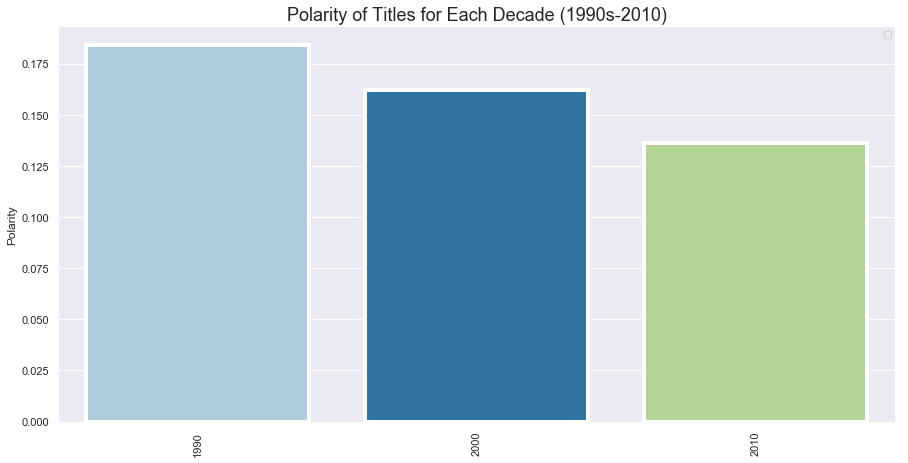

In [151]:
# Billboard Top Artist Award Validation Table 2
sns.set()
sns.set(rc={'figure.figsize':(15,7.27)})

ax = sns.barplot(x=[1990,2000,2010], y=polar_dec2,linewidth=4, data=x, palette="Paired")


#logit
plt.title("Polarity of Titles for Each Decade (1990s-2010)", fontsize=18)

plt.ylabel('Polarity')
plt.legend(loc='best', fontsize=9)
plt.xticks(rotation=90)

plt.show()


Stemming and Lemmatization

In [251]:
from wordcloud import WordCloud

In [252]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
# generate word cloud
wc.generate(' '.join(lyrics['lyrics']))

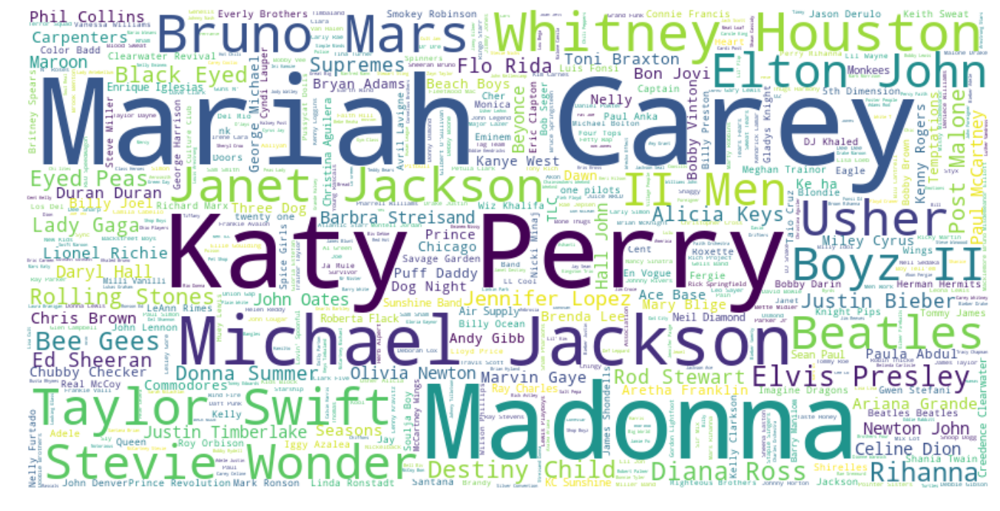

In [154]:
import matplotlib.pyplot as plt
%matplotlib inline
wc.generate(' '.join(billboard.loc[billboard['rank']<=5]['artist1']))
# show
import random
plt.figure(figsize=(24, 12))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
wc.to_file("word_cloud.png")
plt.show()


In [156]:
lyrics.groupby(['artist']).count().sort_values(by='title')

,title,year,lyrics,unique
artist,,,,
"""Mama"" Cass Elliot",1,1,1,1
"Mike WiLL Made-It featuring Miley Cyrus, Wiz Khalifa, and Juicy J",1,1,1,1
Mike Reno and Ann Wilson,1,1,1,1
Mike Post,1,1,1,1
Mike Oldfield,1,1,1,1
Mike Jones,1,1,1,1
Mickey Gilley,1,1,1,1
Michel'le,1,1,1,1
Michael W. Smith,1,1,1,1


In [265]:
sample_size = 5000

def sentiment_func(x):
    sentiment = TextBlob(x['lyrics'])
    x['polarity'] = sentiment.polarity
    x['subjectivity'] = sentiment.subjectivity
    return x

sample10 = lyrics10s.sample(sample_size, replace=True).apply(sentiment_func, axis=1)

In [ ]:
sample.plot.scatter('ups', 'polarity')

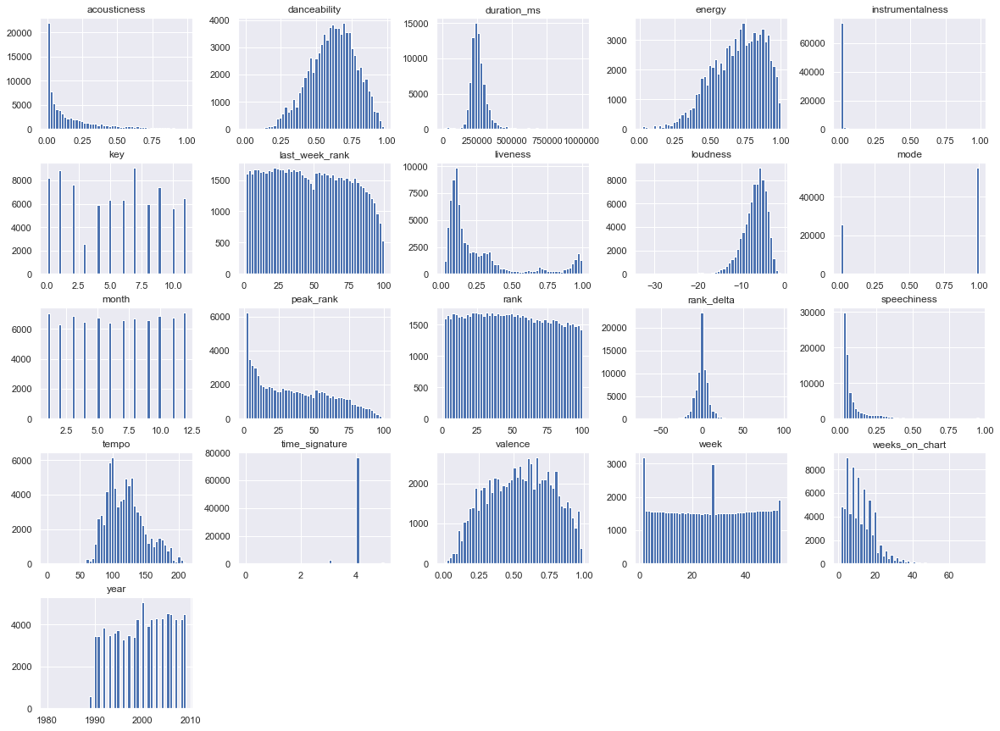

In [560]:
%matplotlib inline
import matplotlib.pyplot as plt
f80_00a.hist(bins=50, figsize=(20,15))
plt.show()

In [225]:
corr_matrix = f2010a.corr()
corr_matrix["rank"].sort_values(ascending=False)

rank                1.000
last_week_rank      0.947
peak_rank           0.829
mode                0.089
tempo               0.055
energy              0.052
liveness            0.023
instrumentalness    0.011
month               0.007
week                0.006
acousticness        0.003
year                0.003
loudness           -0.002
speechiness        -0.006
key                -0.018
duration_ms        -0.032
time_signature     -0.041
valence            -0.041
danceability       -0.133
rank_delta         -0.146
weeks_on_chart     -0.392
Name: rank, dtype: float64

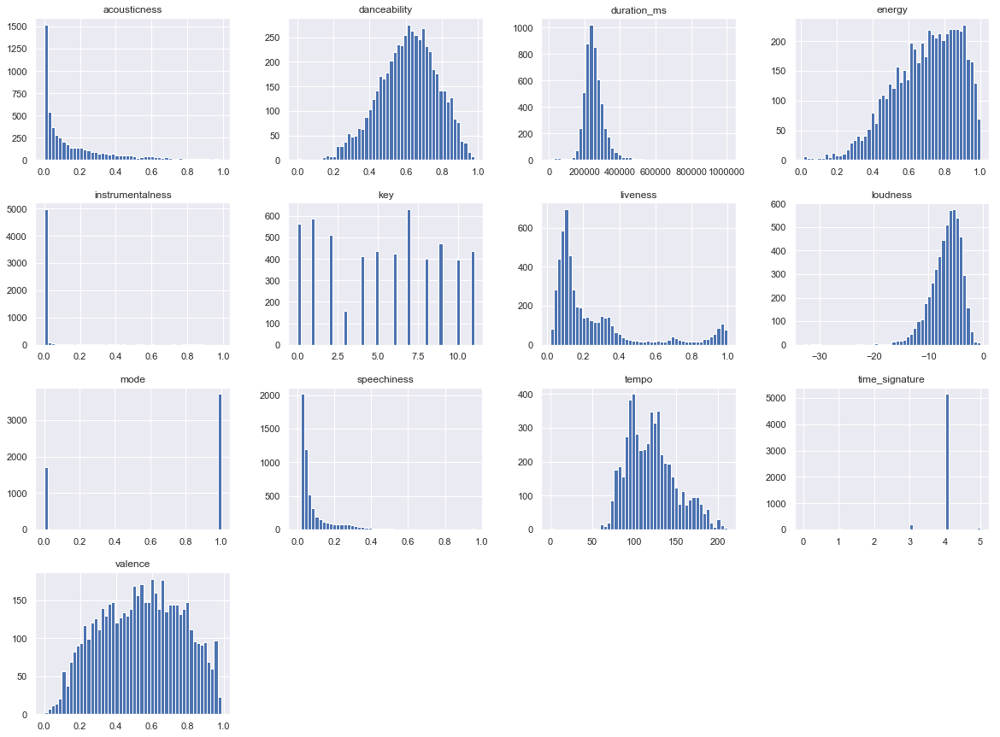

In [260]:
%matplotlib inline
import matplotlib.pyplot as plt
f2000.hist(bins=50, figsize=(20,15))
plt.show()

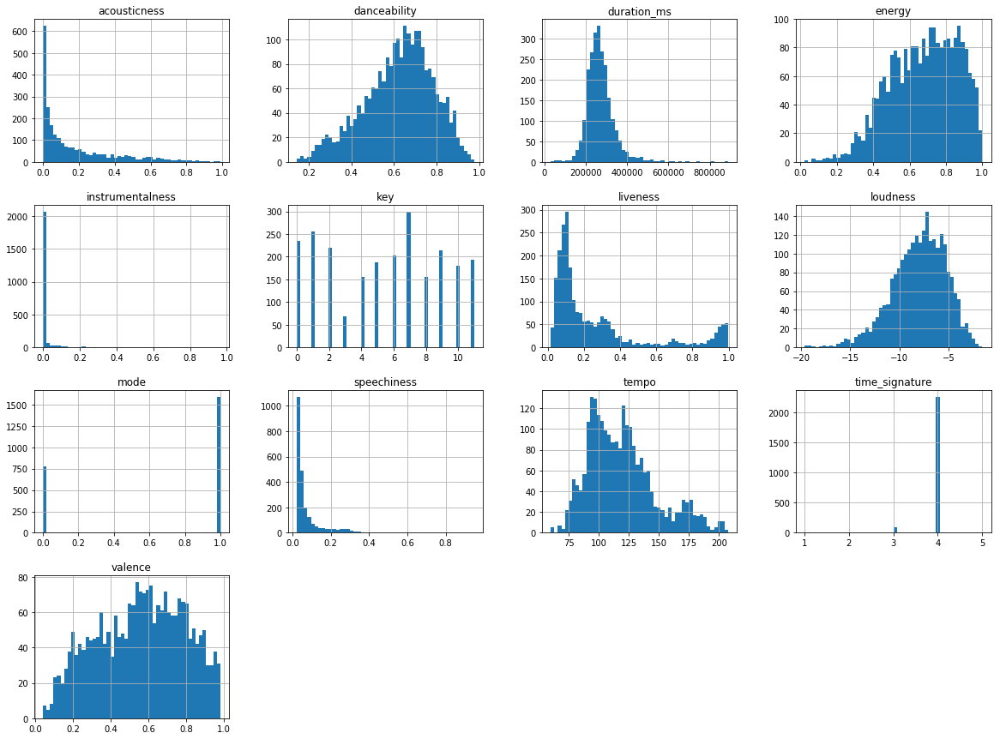

In [53]:
%matplotlib inline
import matplotlib.pyplot as plt
f1990.hist(bins=50, figsize=(20,15))
plt.show()

In [558]:
seasonal_tops('summer',min_date = '2000-01-01')

,track,counts
0,Nelly - Hot In Herre,14
1,Imagine Dragons - Radioactive,14
2,Daft Punk Featuring Pharrell Williams - Get Lucky,14
3,Coldplay - Viva La Vida,13
4,Ed Sheeran - Shape Of You,13
5,Fetty Wap - Trap Queen,13
6,Luis Fonsi & Daddy Yankee Featuring Justin Bie...,13
7,Rihanna - Needed Me,13
8,LMFAO Featuring Lauren Bennett & GoonRock - Pa...,13
9,Bruno Mars - That's What I Like,13


In [142]:

df_summer = billboard.groupby('season').get_group('summer') #Summer
# Weeks on chart >= 12. Rank <= 5
summer_10 = df_summer.loc[df_summer['rank'] <= 5, :].loc[df_summer['weeks_on_chart'] >= 12, :]
summer_102010s = summer_10.loc[df_summer['date_'] >= '2000-01-01', :]
summer_102010s = summer_102010s[['title', 'artist','unique']]
summer_102010s['unique'] = summer_102010s['unique'].str.replace('|', ' - ', regex=False)
summer_2010s_cnt_10 = summer_102010s['unique'].value_counts().to_frame().reset_index()
summer_2010s_cnt_10.columns = ['track', 'counts']
tmp_summer_10 = summer_2010s_cnt_10.iloc[np.arange(0,11),:]
tmp_summer_10.reset_index(drop=  True, inplace = True)
tmp_summer_10


,track,counts
0,Carly Rae Jepsen - Call Me Maybe,13
1,Iggy Azalea Featuring Charli XCX - Fancy,13
2,Luis Fonsi & Daddy Yankee Featuring Justin Bie...,13
3,Bruno Mars - That's What I Like,12
4,LMFAO Featuring Lauren Bennett & GoonRock - Pa...,10
5,Imagine Dragons - Radioactive,10
6,Gotye Featuring Kimbra - Somebody That I Used ...,10
7,Wiz Khalifa Featuring Charlie Puth - See You A...,10
8,Adele - Rolling In The Deep,10
9,Ed Sheeran - Shape Of You,9


Saving figure Summer_'Hot100'_2000s-2010s


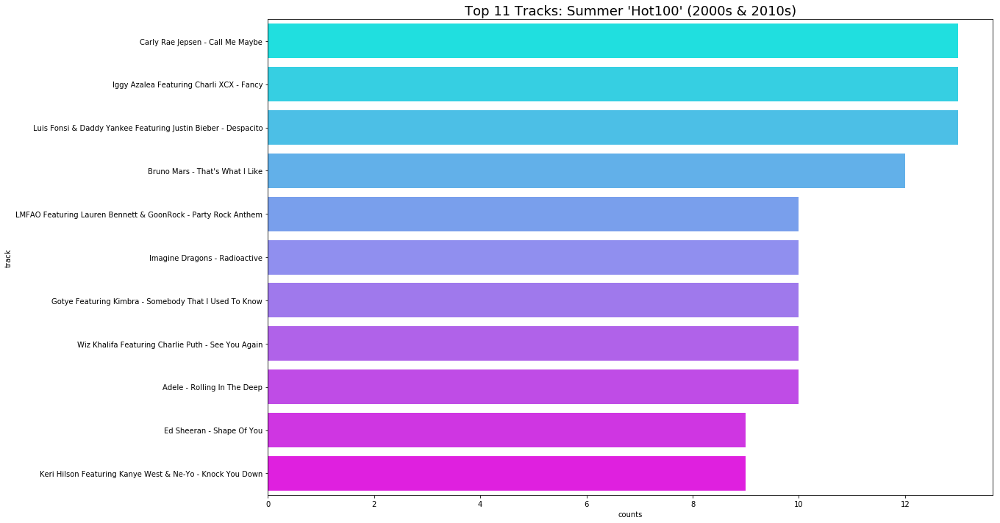

In [164]:
plt.figure(figsize = (19,10))
ax = plt.subplot(1,1,1)
sns.barplot(y = 'track', x = 'counts', data = tmp_summer_10, ax = ax, palette = plt.cm.cool(np.linspace(0,1,11)))
plt.title("Top 11 Tracks: Summer 'Hot100' (2000s & 2010s)", fontsize=18)
save_fig("Summer_'Hot100'_2000s-2010s")
plt.show()

,artist,track,genres,danceability,energy,key,loudness,mode,speechiness,acousticness,...,valence,tempo,type,id,uri,track_href,analysis_url,duration_ms,time_signature,unique
0,Maroon 5,Girls Like You,['pop'],0.611,0.4620,0,-7.054,1,0.0646,0.558000,...,0.3770,59.635,audio_features,6OEHjJJvdkk1Ln0p0AZdyz,spotify:track:6OEHjJJvdkk1Ln0p0AZdyz,https://api.spotify.com/v1/tracks/6OEHjJJvdkk1...,https://api.spotify.com/v1/audio-analysis/6OEH...,215230,4,Maroon 5 Featuring Cardi B|Girls Like You
1,Cardi,I Like It,"['pop', 'rap']",0.816,0.7260,5,-3.998,0,0.1290,0.099000,...,0.6500,136.048,audio_features,58q2HKrzhC3ozto2nDdN4z,spotify:track:58q2HKrzhC3ozto2nDdN4z,https://api.spotify.com/v1/tracks/58q2HKrzhC3o...,https://api.spotify.com/v1/audio-analysis/58q2...,253390,4,"Cardi B, Bad Bunny & J Balvin|I Like It"
2,Post Malone,Better Now,"['pop', 'rap']",0.680,0.5630,10,-5.843,1,0.0454,0.354000,...,0.3740,145.028,audio_features,7dt6x5M1jzdTEt8oCbisTK,spotify:track:7dt6x5M1jzdTEt8oCbisTK,https://api.spotify.com/v1/tracks/7dt6x5M1jzdT...,https://api.spotify.com/v1/audio-analysis/7dt6...,231267,4,Post Malone|Better Now
3,Drake,Nice For What,"['canadian hip hop', 'canadian pop', 'hip hop'...",0.586,0.9090,8,-6.474,1,0.0705,0.089100,...,0.7570,93.394,audio_features,3CA9pLiwRIGtUBiMjbZmRw,spotify:track:3CA9pLiwRIGtUBiMjbZmRw,https://api.spotify.com/v1/tracks/3CA9pLiwRIGt...,https://api.spotify.com/v1/audio-analysis/3CA9...,210747,4,Drake|Nice For What
4,Ella Mai,Boo'd Up,"['dance pop', 'pop', 'r&b', 'uk contemporary r...",0.397,0.8430,10,-3.726,0,0.0987,0.158000,...,0.2200,81.201,audio_features,4squZv12LD9M8ooJfoVgZS,spotify:track:4squZv12LD9M8ooJfoVgZS,https://api.spotify.com/v1/tracks/4squZv12LD9M...,https://api.spotify.com/v1/audio-analysis/4squ...,239341,4,Ella Mai|Boo'd Up
5,Drake,God's Plan,"['canadian hip hop', 'canadian pop', 'hip hop'...",0.754,0.4490,7,-9.211,1,0.1090,0.033200,...,0.3570,77.169,audio_features,6DCZcSspjsKoFjzjrWoCdn,spotify:track:6DCZcSspjsKoFjzjrWoCdn,https://api.spotify.com/v1/tracks/6DCZcSspjsKo...,https://api.spotify.com/v1/audio-analysis/6DCZ...,198973,4,Drake|God's Plan
6,XXXTENTACION,SAD!,"['emo rap', 'miami hip hop']",0.740,0.6130,8,-4.880,1,0.1450,0.258000,...,0.4730,75.023,audio_features,3ee8Jmje8o58CHK66QrVC2,spotify:track:3ee8Jmje8o58CHK66QrVC2,https://api.spotify.com/v1/tracks/3ee8Jmje8o58...,https://api.spotify.com/v1/audio-analysis/3ee8...,166606,4,XXXTENTACION|Sad!
7,Post Malone,Psycho (feat. Ty Dolla $ign),"['pop', 'rap']",0.739,0.5590,8,-8.011,1,0.1170,0.580000,...,0.4390,140.124,audio_features,3swc6WTsr7rl9DqQKQA55C,spotify:track:3swc6WTsr7rl9DqQKQA55C,https://api.spotify.com/v1/tracks/3swc6WTsr7rl...,https://api.spotify.com/v1/audio-analysis/3swc...,221440,4,Post Malone Featuring Ty Dolla $ign|Psycho
8,Luis Fonsi,Despacito,"['dance pop', 'latin', 'latin pop', 'pop']",0.655,0.7970,2,-4.787,1,0.1530,0.198000,...,0.8390,177.928,audio_features,6habFhsOp2NvshLv26DqMb,spotify:track:6habFhsOp2NvshLv26DqMb,https://api.spotify.com/v1/tracks/6habFhsOp2Nv...,https://api.spotify.com/v1/audio-analysis/6hab...,229360,4,Luis Fonsi & Daddy Yankee Featuring Justin Bie...
9,French Montana,Unforgettable,"['hip hop', 'pop', 'pop rap', 'rap', 'southern...",0.726,0.7690,6,-5.043,1,0.1230,0.029300,...,0.7330,97.985,audio_features,3B54sVLJ402zGa6Xm4YGNe,spotify:track:3B54sVLJ402zGa6Xm4YGNe,https://api.spotify.com/v1/tracks/3B54sVLJ402z...,https://api.spotify.com/v1/audio-analysis/3B54...,233902,4,French Montana Featuring Swae Lee|Unforgettable


In [541]:
seasonal_tops(season='summer',min_date = '2000-01-01')

,track,counts
0,Jennifer Lopez Featuring Nas - I'm Gonna Be Al...,14
1,Zedd Featuring Foxes - Clarity,14
2,Daft Punk Featuring Pharrell Williams - Get Lucky,14
3,Chad Kroeger Featuring Josey Scott - Hero,14
4,Imagine Dragons - Radioactive,14
5,Ariana Grande Featuring Mac Miller - The Way,14
6,Justin Timberlake - Mirrors,14
7,Vanessa Carlton - A Thousand Miles,14
8,Robin Thicke Featuring T.I. + Pharrell - Blurr...,14
9,Nelly - Hot In Herre,14


In [538]:
def seasonal_tops(season='winter', top_x = 11, rank =10, peak_rank=5, weeks_on_chart = 12, min_date = '1958-08-16', max_date = '2019-04-13'):
    df_season = billboard.groupby('season').get_group(season)
    temp_season = df_season.loc[df_season['rank'] <= rank, :].loc[df_season['weeks_on_chart'] >= 3, :]
    temp_season_time =  temp_season.loc[df_season['date_'] >= min_date, :].loc[temp_season['date_'] <= max_date, :]
    temp_season_time = temp_season_time[['title', 'artist','unique']] 
    temp_season_time['unique'] = temp_season_time['unique'].str.replace('|', ' - ', regex=False)
    temp_season_time_cnt = temp_season_time['unique'].value_counts().to_frame().reset_index()
    temp_season_time_cnt.columns = ['track', 'counts']

    return temp_season_time_cnt

In [510]:
a = billboard.groupby('year').get_group(2018)
b = a.loc[a['peak_rank'] <= 10, :]
b['unique'] = b['unique'].str.replace('|', ' - ', regex=False)
b

C:\Users\Paul Cho\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,artist,date_,last_week_rank,peak_rank,rank,title,weeks_on_chart,artist1,featuring,rank_delta,year,month,week,unique,season
1500,Ariana Grande,2018-12-29,1.0,1.0,1,"Thank U, Next",7.0,Ariana Grande,Ariana Grande,0.0,2018,12,52,"Ariana Grande - Thank U, Next",winter
1501,Halsey,2018-12-29,2.0,2.0,2,Without Me,11.0,Halsey,Halsey,0.0,2018,12,52,Halsey - Without Me,winter
1502,Travis Scott,2018-12-29,3.0,1.0,3,Sicko Mode,20.0,Travis Scott,Travis Scott,0.0,2018,12,52,Travis Scott - Sicko Mode,winter
1503,Post Malone & Swae Lee,2018-12-29,7.0,4.0,4,Sunflower (Spider-Man: Into The Spider-Verse),9.0,Post Malone,Swae Lee,3.0,2018,12,52,Post Malone & Swae Lee - Sunflower (Spider-Man...,winter
1504,Marshmello & Bastille,2018-12-29,4.0,3.0,5,Happier,18.0,Marshmello,Bastille,-1.0,2018,12,52,Marshmello & Bastille - Happier,winter
1505,Panic! At The Disco,2018-12-29,5.0,5.0,6,High Hopes,20.0,Panic! At The Disco,Panic! At The Disco,-1.0,2018,12,52,Panic! At The Disco - High Hopes,winter
1506,Mariah Carey,2018-12-29,6.0,6.0,7,All I Want For Christmas Is You,29.0,Mariah Carey,Mariah Carey,-1.0,2018,12,52,Mariah Carey - All I Want For Christmas Is You,winter
1507,Kodak Black Featuring Travis Scott & Offset,2018-12-29,9.0,2.0,8,ZEZE,10.0,Kodak Black,Travis Scott | Offset,1.0,2018,12,52,Kodak Black Featuring Travis Scott & Offset - ...,winter
1508,Lil Baby & Gunna,2018-12-29,8.0,4.0,9,Drip Too Hard,14.0,Lil Baby,Gunna,-1.0,2018,12,52,Lil Baby & Gunna - Drip Too Hard,winter
1509,Andy Williams,2018-12-29,13.0,10.0,10,It's The Most Wonderful Time Of The Year,9.0,Andy Williams,Andy Williams,3.0,2018,12,52,Andy Williams - It's The Most Wonderful Time O...,winter


In [511]:
c = b['unique'].value_counts()[:10]
a = b[(b['unique'].isin(c.index.values)) & (b['year']==2018)]
a

,artist,date_,last_week_rank,peak_rank,rank,title,weeks_on_chart,artist1,featuring,rank_delta,year,month,week,unique,season
1514,Maroon 5 Featuring Cardi B,2018-12-29,10.0,1.0,15,Girls Like You,30.0,Maroon 5,Cardi B,-5.0,2018,12,52,Maroon 5 Featuring Cardi B - Girls Like You,winter
1520,Post Malone,2018-12-29,20.0,3.0,21,Better Now,34.0,Post Malone,Post Malone,-1.0,2018,12,52,Post Malone - Better Now,winter
1522,Juice WRLD,2018-12-29,19.0,2.0,23,Lucid Dreams,32.0,Juice WRLD,Juice WRLD,-4.0,2018,12,52,Juice WRLD - Lucid Dreams,winter
1539,"Cardi B, Bad Bunny & J Balvin",2018-12-29,38.0,1.0,40,I Like It,37.0,Cardi,Bad Bunny | J Balvin,-2.0,2018,12,52,"Cardi B, Bad Bunny & J Balvin - I Like It",winter
1609,Maroon 5 Featuring Cardi B,2018-12-22,11.0,1.0,10,Girls Like You,29.0,Maroon 5,Cardi B,1.0,2018,12,51,Maroon 5 Featuring Cardi B - Girls Like You,winter
1618,Juice WRLD,2018-12-22,13.0,2.0,19,Lucid Dreams,31.0,Juice WRLD,Juice WRLD,-6.0,2018,12,51,Juice WRLD - Lucid Dreams,winter
1619,Post Malone,2018-12-22,15.0,3.0,20,Better Now,33.0,Post Malone,Post Malone,-5.0,2018,12,51,Post Malone - Better Now,winter
1637,"Cardi B, Bad Bunny & J Balvin",2018-12-22,42.0,1.0,38,I Like It,36.0,Cardi,Bad Bunny | J Balvin,4.0,2018,12,51,"Cardi B, Bad Bunny & J Balvin - I Like It",winter
1710,Maroon 5 Featuring Cardi B,2018-12-15,9.0,1.0,11,Girls Like You,28.0,Maroon 5,Cardi B,-2.0,2018,12,50,Maroon 5 Featuring Cardi B - Girls Like You,winter
1712,Juice WRLD,2018-12-15,10.0,2.0,13,Lucid Dreams,30.0,Juice WRLD,Juice WRLD,-3.0,2018,12,50,Juice WRLD - Lucid Dreams,winter


In [182]:
# 2018 top 10 tracks
a = billboard[(billboard['year']==2018)]['unique'].value_counts()[:10]
top1018 = billboard[(billboard['unique'].isin(a.index.values)) & (billboard['year']==2018)]



In [18]:
def top10Artist_of_year(year):
    df_season = billboard.groupby('year').get_group(year)
    temp_season = df_season.loc[df_season['rank'] <= 50, :]['unique'].value_counts()[:10]
    v = df_season[(df_season['unique'].isin(temp_season.index.values)) & (df_season['year']==year)]
    v['unique'] = v['unique'].str.replace('|', ' - ', regex=False)
    return v

In [19]:
df_2017 = top10Artist_of_year(2017)

C:\Users\Young Min Cho\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [ ]:
def seasonal_tops(season='winter', top_x = 11, rank =10, peak_rank=5, weeks_on_chart = 12, min_date = '1958-08-16', max_date = '2019-04-13'):
    df_season = billboard.groupby('season').get_group(season)
    temp_season = df_season.loc[df_season['rank'] <= rank, :].loc[df_season['weeks_on_chart'] >= 3, :]
    temp_season_time =  temp_season.loc[df_season['date_'] >= min_date, :].loc[temp_season['date_'] <= max_date, :]
    temp_season_time = temp_season_time[['title', 'artist','unique']] 
    temp_season_time['unique'] = temp_season_time['unique'].str.replace('|', ' - ', regex=False)
    temp_season_time_cnt = temp_season_time['unique'].value_counts().to_frame().reset_index()
    temp_season_time_cnt.columns = ['track', 'counts']

    return temp_season_time_cnt

Saving figure HighR_manyApp_2017


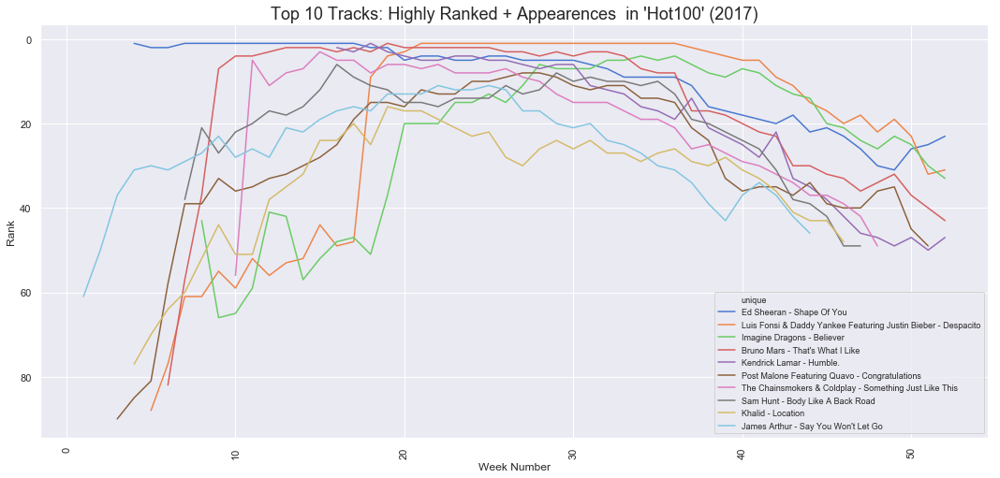

In [22]:
import calendar
sns.set(rc={'figure.figsize':(15,7.27)})
ax = sns.lineplot(x="week", y='rank', hue='unique', data=df_2017, palette="muted")
plt.gca().invert_yaxis()

#logit
plt.title("Top 10 Tracks: Highly Ranked + Appearences  in 'Hot100' (2017)", fontsize=18)
plt.xlabel('Week Number')
plt.ylabel('Rank')
plt.legend(loc='best', fontsize=9)
plt.xticks(rotation=90)
save_fig("HighR_manyApp_2017")
plt.show()

In [ ]:
billboard

spring_10 = df_spring[['Track Name', 'Position']].loc[df_spring.Position <= 10, :]




In [42]:
### 10 - Most total weeks on the Hot 100
mwh100 = billboard[billboard['rank']<=100]['unique'].value_counts()[:50]
billboard[billboard['unique'].isin(mwh100.index.values)].drop_duplicates('unique')

,artist,date_,last_week_rank,peak_rank,rank,title,weeks_on_chart,artist1,featuring,year,month,rank_delta,unique
2720,Ed Sheeran,2018-10-06,23.0,1.0,21,Perfect,57.0,Ed Sheeran,Ed Sheeran,2018,10,2.0,Ed Sheeran Perfect
4933,Avicii,2018-05-05,NaN,4.0,34,Wake Me Up!,54.0,Avicii,Avicii,2018,5,NaN,Avicii Wake Me Up!
5823,Ed Sheeran,2018-03-03,24.0,1.0,24,Shape Of You,59.0,Ed Sheeran,Ed Sheeran,2018,3,0.0,Ed Sheeran Shape Of You
8738,The Chainsmokers Featuring Halsey,2017-08-12,36.0,1.0,39,Closer,52.0,The Chainsmokers,Halsey,2017,8,-3.0,The Chainsmokers Featuring Halsey Closer
11131,Sia Featuring Sean Paul,2017-02-25,30.0,1.0,32,Cheap Thrills,52.0,Sia,Sean Paul,2017,2,-2.0,Sia Featuring Sean Paul Cheap Thrills
16048,Wiz Khalifa Featuring Charlie Puth,2016-03-19,45.0,1.0,49,See You Again,52.0,Wiz Khalifa,Charlie Puth,2016,3,-4.0,Wiz Khalifa Featuring Charlie Puth See You Again
16221,Mark Ronson Featuring Bruno Mars,2016-03-05,NaN,1.0,22,Uptown Funk!,56.0,Mark Ronson,Bruno Mars,2016,3,NaN,Mark Ronson Featuring Bruno Mars Uptown Funk!
17638,WALK THE MOON,2015-11-28,38.0,4.0,39,Shut Up And Dance,53.0,WALK THE MOON,WALK THE MOON,2015,11,-1.0,WALK THE MOON Shut Up And Dance
17644,Ed Sheeran,2015-11-28,41.0,2.0,45,Thinking Out Loud,58.0,Ed Sheeran,Ed Sheeran,2015,11,-4.0,Ed Sheeran Thinking Out Loud
20649,Sam Smith,2015-05-02,49.0,2.0,50,Stay With Me,54.0,Sam Smith,Sam Smith,2015,5,-1.0,Sam Smith Stay With Me


In [204]:
# 10 - Most total weeks in the top ten
billboard[billboard['rank']<=10]['key'].value_counts()[:10]

Maroon 5 Featuring Cardi B Girls Like You                      33
Ed Sheeran Shape Of You                                        33
LeAnn Rimes How Do I Live                                      32
The Chainsmokers Featuring Halsey Closer                       32
Travis Scott Sicko Mode                                        32
Mark Ronson Featuring Bruno Mars Uptown Funk!                  31
Santana Featuring Rob Thomas Smooth                            30
LMFAO Featuring Lauren Bennett & GoonRock Party Rock Anthem    29
Bruno Mars That's What I Like                                  28
Jewel Foolish Games/You Were Meant For Me                      28
Name: key, dtype: int64

In [53]:
# most number 1 singles
billboard[billboard['rank']==1].drop_duplicates(['title'])


,artist,date_,last_week_rank,peak_rank,rank,title,weeks_on_chart,artist1,featuring
0,Post Malone & Swae Lee,2019-01-19,3,1.0,1,Sunflower (Spider-Man: Into The Spider-Verse),12.0,Post Malone,Swae Lee
100,Halsey,2019-01-26,2,1.0,1,Without Me,15.0,Halsey,Halsey
200,Ariana Grande,2019-02-02,NaN,NaN,1,7 Rings,NaN,Ariana Grande,Ariana Grande
700,Lady Gaga & Bradley Cooper,2019-03-09,21,1.0,1,Shallow,22.0,Lady Gaga,Bradley Cooper
800,Jonas Brothers,2019-03-16,NaN,NaN,1,Sucker,NaN,Jonas Brothers,Jonas Brothers
1200,Lil Nas X Featuring Billy Ray Cyrus,2019-04-13,15,1.0,1,Old Town Road,5.0,Lil Nas,| Billy Ray Cyrus
1300,Drake,2018-04-07,1,1.0,1,God's Plan,10.0,Drake,Drake
1500,Drake,2018-04-21,NaN,NaN,1,Nice For What,NaN,Drake,Drake
1600,Domenico Modugno,1958-08-16,2,1.0,1,Nel Blu Dipinto Di Blu (Volaré),3.0,Domenico Modugno,Domenico Modugno
1682,The Elegants,1958-08-23,2,1.0,1,Little Star,4.0,The Elegants,The Elegants


In [263]:
billboard.groupby('artist1')['rank'].count().sort_values(ascending=False)

artist1
Drake                                                            1247
Taylor Swift                                                      945
Rihanna                                                           916
Elton John                                                        886
Elvis Presley                                                     880
Madonna                                                           862
Kenny Chesney                                                     845
Tim McGraw                                                        813
Chris Brown                                                       751
Usher                                                             723
Mariah Carey                                                      717
Beyonce                                                           683
Keith Urban                                                       682
Maroon 5                                                          674
Rod Stewart 

In [264]:
billboard.loc[billboard['artist1']=='Mariah Carey',:]

,artist,date_,last_week_rank,peak_rank,rank,title,weeks_on_chart,artist1,featuring,rank_delta,year,month,week,unique,season
1402,Mariah Carey,2019-01-05,7.000,3.000,3,All I Want For Christmas Is You,30.000,Mariah Carey,Mariah Carey,4.000,2019,1,1,Mariah Carey|All I Want For Christmas Is You,winter
1506,Mariah Carey,2018-12-29,6.000,6.000,7,All I Want For Christmas Is You,29.000,Mariah Carey,Mariah Carey,-1.000,2018,12,52,Mariah Carey|All I Want For Christmas Is You,winter
1605,Mariah Carey,2018-12-22,7.000,6.000,6,All I Want For Christmas Is You,28.000,Mariah Carey,Mariah Carey,1.000,2018,12,51,Mariah Carey|All I Want For Christmas Is You,winter
1706,Mariah Carey,2018-12-15,14.000,7.000,7,All I Want For Christmas Is You,27.000,Mariah Carey,Mariah Carey,7.000,2018,12,50,Mariah Carey|All I Want For Christmas Is You,winter
1813,Mariah Carey,2018-12-08,29.000,9.000,14,All I Want For Christmas Is You,26.000,Mariah Carey,Mariah Carey,15.000,2018,12,49,Mariah Carey|All I Want For Christmas Is You,winter
1928,Mariah Carey,2018-12-01,nan,9.000,29,All I Want For Christmas Is You,25.000,Mariah Carey,Mariah Carey,nan,2018,12,48,Mariah Carey|All I Want For Christmas Is You,winter
6612,Mariah Carey,2018-01-06,9.000,9.000,13,All I Want For Christmas Is You,24.000,Mariah Carey,Mariah Carey,-4.000,2018,1,1,Mariah Carey|All I Want For Christmas Is You,winter
6708,Mariah Carey,2017-12-30,11.000,9.000,9,All I Want For Christmas Is You,22.000,Mariah Carey,Mariah Carey,2.000,2017,12,52,Mariah Carey|All I Want For Christmas Is You,winter
6810,Mariah Carey,2017-12-23,21.000,11.000,11,All I Want For Christmas Is You,21.000,Mariah Carey,Mariah Carey,10.000,2017,12,51,Mariah Carey|All I Want For Christmas Is You,winter
6920,Mariah Carey,2017-12-16,nan,11.000,21,All I Want For Christmas Is You,20.000,Mariah Carey,Mariah Carey,nan,2017,12,50,Mariah Carey|All I Want For Christmas Is You,winter


In [258]:
billboard[billboard['rank']<=5]['artist1'].value_counts()

Mariah Carey                                       186
The Beatles                                        156
Rihanna                                            151
Usher                                              143
Madonna                                            139
Katy Perry                                         132
Whitney Houston                                    112
Bruno Mars                                         108
Maroon 5                                           107
Michael Jackson                                     97
Drake                                               96
Janet Jackson                                       92
Taylor Swift                                        90
Boyz II Men                                         85
Beyonce                                             84
Elvis Presley                                       83
Nelly                                               81
Elton John                                          77
TLC       